# Поиск по изображениям

## Описание проекта

Вы работаете в фотохостинге для профессиональных фотографов «Со Смыслом» (“With Sense”).
Ваши пользователи размещают свои фотографии на хостинге и сопровождают их полным описанием: указывают место съёмок, модель камеры и т. д. Отличительная особенность сервиса — описание: его может предоставить не только тот, кто размещает фотографию, но и другие пользователи портала.

## Цель исследованние

Создаьть модель для прогнозирования лучшей запрось к изображению.

## Ход исследованние

- Подгатовка данных: Загрузка и изучение общей информации из предоставлено датасета.

- Исследовательский анализ данных: Изучить распределение оценок

- Обучение модели посредством перекрестной проверки и находите лучшую

- Построение нейросети чтобы определит насколько близко запрос к изображеннии

- Анализ резултата обученния

In [1]:
!pip install -q bert_score
!pip install -q -U sentence-transformers
!pip install -q tf-keras

In [2]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import random
import matplotlib.image as mpimg

from nltk.tokenize import TweetTokenizer

import re

from tqdm import notebook

from nltk.translate.bleu_score import sentence_bleu

import torch
import torch.nn as nn
import torchvision.models as models
from torchvision import transforms

from transformers import BertTokenizer, BertModel
from bert_score import BERTScorer

from PIL import Image
import os

from sklearn.model_selection import GroupShuffleSplit, RandomizedSearchCV

from sklearn.pipeline import Pipeline

# загружаем нужные модели для regression
from sklearn.ensemble import RandomForestRegressor
from sklearn.dummy import DummyRegressor
from sklearn.svm import SVR
from sklearn.linear_model import ElasticNet

from sklearn.metrics import mean_absolute_error, r2_score

from sentence_transformers import SentenceTransformer

import warnings
warnings.filterwarnings('ignore')

2025-04-21 14:43:58.223949: I tensorflow/core/util/port.cc:153] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2025-04-21 14:43:58.237939: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:467] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1745235838.254269   31086 cuda_dnn.cc:8579] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1745235838.259253   31086 cuda_blas.cc:1407] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
W0000 00:00:1745235838.272012   31086 computation_placer.cc:177] computation placer already registered. Please check linkage and avoid linking 

In [3]:
# загрузка датасета

!wget -q https://code.s3.yandex.net/datasets/dsplus_integrated_project_4.zip
!unzip -q dsplus_integrated_project_4.zip

DATA_PATH = './to_upload/'

# Загрузка данных

## Загрузка тренировочной датасеть

In [4]:
df_train = pd.read_csv(os.path.join(DATA_PATH,'train_dataset.csv'))

In [5]:
df_train.head()

,image,query_id,query_text
0,1056338697_4f7d7ce270.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...
1,1262583859_653f1469a9.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...
2,2447284966_d6bbdb4b6e.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...
3,2549968784_39bfbe44f9.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...
4,2621415349_ef1a7e73be.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...


In [6]:
df_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5822 entries, 0 to 5821
Data columns (total 3 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   image       5822 non-null   object
 1   query_id    5822 non-null   object
 2   query_text  5822 non-null   object
dtypes: object(3)
memory usage: 136.6+ KB


In [7]:
df_train.duplicated().sum()

0

df_train cодержит 5822 обектов и нет пропусков и нет дюпликатов!

В этом фрейме данных есть три категориальные признаки:
- image, название изображения в папке train_images
- query_id, идентификатор запроса
- query_text, подпись к картинкам


## Загрузка тестовой датасеть

In [8]:
df_test = pd.read_csv(os.path.join(DATA_PATH,'test_queries.csv'),\
                                    sep='|', \
                                    usecols=[1, 2, 3])

In [9]:
df_test.head()

,query_id,query_text,image
0,1177994172_10d143cb8d.jpg#0,"Two blonde boys , one in a camouflage shirt an...",1177994172_10d143cb8d.jpg
1,1177994172_10d143cb8d.jpg#1,Two boys are squirting water guns at each other .,1177994172_10d143cb8d.jpg
2,1177994172_10d143cb8d.jpg#2,Two boys spraying each other with water,1177994172_10d143cb8d.jpg
3,1177994172_10d143cb8d.jpg#3,Two children wearing jeans squirt water at eac...,1177994172_10d143cb8d.jpg
4,1177994172_10d143cb8d.jpg#4,Two young boys are squirting water at each oth...,1177994172_10d143cb8d.jpg


Этот датафрейм содержить как у df_train, три категориальные признаки:
- image, название изображения в папке test_images
- query_id, идентификатор запроса
- query_text, запрос к картинкам

Набор тестовых данных содержит 100 изображений, и мы получили по 5 запросов на каждое изображение, таким образом, запросы df_test содержат 500 объектов.

## Загрузка оценок, сделанных толпой

In [10]:
df_crowd_notation = pd.read_csv(os.path.join(DATA_PATH, 'CrowdAnnotations.tsv'), \
                                sep = '\t', \
                                header=None)

In [11]:
# Именование столбцов
df_crowd_notation.columns = ['image', 'query_id', 'share_fitting', 'fitting', 'not_fitting']

In [12]:
df_crowd_notation.head()

,image,query_id,share_fitting,fitting,not_fitting
0,1056338697_4f7d7ce270.jpg,1056338697_4f7d7ce270.jpg#2,1.0,3,0
1,1056338697_4f7d7ce270.jpg,114051287_dd85625a04.jpg#2,0.0,0,3
2,1056338697_4f7d7ce270.jpg,1427391496_ea512cbe7f.jpg#2,0.0,0,3
3,1056338697_4f7d7ce270.jpg,2073964624_52da3a0fc4.jpg#2,0.0,0,3
4,1056338697_4f7d7ce270.jpg,2083434441_a93bc6306b.jpg#2,0.0,0,3


In [13]:
df_crowd_notation.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 47830 entries, 0 to 47829
Data columns (total 5 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   image          47830 non-null  object 
 1   query_id       47830 non-null  object 
 2   share_fitting  47830 non-null  float64
 3   fitting        47830 non-null  int64  
 4   not_fitting    47830 non-null  int64  
dtypes: float64(1), int64(2), object(2)
memory usage: 1.8+ MB


In [14]:
df_crowd_notation.duplicated().sum()

0

Толпа людей оценила, насколько близки подписи к изображению, к которому они привязаны. Этот датафрейм данных содержит 47830 объектов и 5 столбцов:
Этот датафрейм содержить как пять категориальные признаки:
- image, название изображения в папке train_images
- query_id, идентификатор запроса
- share_fitting, доля исполнителей, подтвердивших, что текст соответствует картинке.
- fitting, количество исполнителей, подтвердивших, что текст соответствует картинке
- not_fitting, количество исполнителей, подтвердивших, что текст не соответствует картинке

В этом датсете нет пропущенных значений и явных дубликатов.

In [15]:
df_crowd_notation['total_judges'] = df_crowd_notation['fitting'] + df_crowd_notation['not_fitting']

In [16]:
df_crowd_notation['total_judges'].value_counts()

total_judges
3    46780
4      780
5      220
6       50
Name: count, dtype: int64

Мы видим, что существует несоответствие в количестве избирателей среди толпы.

## Загрузка оценок, сделанных экспертов

In [17]:
df_experts_notation = pd.read_csv(os.path.join(DATA_PATH, 'ExpertAnnotations.tsv'),\
                                  sep = '\t', \
                                  header=None)

In [18]:
# Именование столбцов
df_experts_notation.columns = ['image', 'query_id', 'exp_1', 'exp_2', 'exp_3']

In [19]:
df_experts_notation.head()

,image,query_id,exp_1,exp_2,exp_3
0,1056338697_4f7d7ce270.jpg,2549968784_39bfbe44f9.jpg#2,1,1,1
1,1056338697_4f7d7ce270.jpg,2718495608_d8533e3ac5.jpg#2,1,1,2
2,1056338697_4f7d7ce270.jpg,3181701312_70a379ab6e.jpg#2,1,1,2
3,1056338697_4f7d7ce270.jpg,3207358897_bfa61fa3c6.jpg#2,1,2,2
4,1056338697_4f7d7ce270.jpg,3286822339_5535af6b93.jpg#2,1,1,2


In [20]:
df_experts_notation.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5822 entries, 0 to 5821
Data columns (total 5 columns):
 #   Column    Non-Null Count  Dtype 
---  ------    --------------  ----- 
 0   image     5822 non-null   object
 1   query_id  5822 non-null   object
 2   exp_1     5822 non-null   int64 
 3   exp_2     5822 non-null   int64 
 4   exp_3     5822 non-null   int64 
dtypes: int64(3), object(2)
memory usage: 227.6+ KB


In [21]:
df_experts_notation.duplicated().sum()

0

Этот датафрей данных содержит только 5822 объекта, таких как набор обучающих данных, и 5 столбцов:

- image, название изображения в папке train_images
- query_id, идентификатор запроса
- exp_1, оценки первой эксперт
- exp_2, оценки второй эксперт
- exp_3, оценки третий эксперт

В этом датасет нет пропущенных значений и дубликатов.

## Различные запросы из query_text

In [22]:
list_query_text_train = df_train['query_text'].value_counts().index.to_list()
print(f'Есть {len(list_query_text_train)} разные подзапросы в тренировочном датасете.')

Есть 977 разные подзапросы в тренировочном датасете.


In [23]:
list_query_text_train

['Two dogs , one brown and white and one black and white , run on a field .',
 'A grey dog walks on top of a fallen tree in the woods .',
 'a white woman in a green sweater holds a smiling child whilst a smiling boy in a yellow shirt looks on .',
 'A crowd of people at an outdoor event',
 'Two dogs run down a dirt path in the forest .',
 'A group of five adults stand posing in front of buildings .',
 'A dog is running along the beach beside the ocean .',
 'An officer stands next to a car on a city street .',
 'A Miami basketball player dribbles by an Arizona State player .',
 'A young girl is wearing a purple shirt and pink headband .',
 'A group of people walking a city street in warm weather .',
 'a skier is throwing up snow as he skis off piste .',
 'A man standing in front of a brick building .',
 'A man scales a rock in the forest .',
 'An asian man in a suit on the subway , asleep .',
 'The large brown dog is chasing after the little brown dog .',
 'Two men and a woman smile at t

Большую часть запросов - короткие. Знаков препинания почти нет, точка в конце, иногда апостроф.
Мы видим, что ключевые слова могут быть такими:
- что это такое: 'boys', 'man'
- сколько: 'two', 'four'
- многие глаголы стоят в форме герундия: 'eating', 'sitting'
- упоминание цветов: 'black dog', 'blue jeans'
- часть окружения: 'grass', 'snow'
- конкретные объекты : 'sunglasses', 'newspaper'


## Features Engineering : Нормализация оценок экспертов

In [24]:
# Нормализация оценок экспертов
df_experts_notation['mean_norm'] = (df_experts_notation['exp_1'] + df_experts_notation['exp_2'] + df_experts_notation['exp_2'] - 3) / 9

## Создание целевой переменной

Поскольку нам нужно присвоить изображениям оценку от 0 до 1, исходя из различных оценок только толпы и/или только экспертов, нам придется решить задачу регрессии.
Наш еловой перемены должно быть число от 0 до 1, мы попытаемся получить среднее значение оценок между экспертами и толпой.

Следует отметить, что эксперты соблюдали определенную шкалу в своих оценках: последняя могла быть 1, 2, 3 или 4 (Эксперты ставят оценки по шкале от 1 до 4, где 1 — изображение и запрос совершенно не соответствуют друг другу, 2 — запрос содержит элементы описания изображения, но в целом запрос тексту не соответствует, 3 — запрос и текст соответствуют с точностью до некоторых деталей, 4 — запрос и текст соответствуют полностью.).

Однако толпа просто поставила 0 или 1.

Более того, у нас нет постоянства в количестве судей. Действительно, у нас всегда 3 эксперта, но толпы могло быть и 3, 4, 5.

In [25]:
# Объединение экспертной записи с данными поезда, имеющими такое же количество объектов
merge_train_experts = df_train.merge(df_experts_notation, how='inner', on=['image', 'query_id'])

In [26]:
merge_train_experts.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5822 entries, 0 to 5821
Data columns (total 7 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   image       5822 non-null   object 
 1   query_id    5822 non-null   object 
 2   query_text  5822 non-null   object 
 3   exp_1       5822 non-null   int64  
 4   exp_2       5822 non-null   int64  
 5   exp_3       5822 non-null   int64  
 6   mean_norm   5822 non-null   float64
dtypes: float64(1), int64(3), object(3)
memory usage: 318.5+ KB


Нет пропущенных значений.

In [27]:
merge_train = merge_train_experts.merge(df_crowd_notation, how='left', on=['image', 'query_id'])

In [28]:
merge_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5822 entries, 0 to 5821
Data columns (total 11 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   image          5822 non-null   object 
 1   query_id       5822 non-null   object 
 2   query_text     5822 non-null   object 
 3   exp_1          5822 non-null   int64  
 4   exp_2          5822 non-null   int64  
 5   exp_3          5822 non-null   int64  
 6   mean_norm      5822 non-null   float64
 7   share_fitting  2329 non-null   float64
 8   fitting        2329 non-null   float64
 9   not_fitting    2329 non-null   float64
 10  total_judges   2329 non-null   float64
dtypes: float64(5), int64(3), object(3)
memory usage: 500.5+ KB


In [29]:
# Давайте создадим нашу цель. На данный момент мы будем называть это оценкой.
def evaluations(row):
  if np.isnan(row['share_fitting']):
    return row['mean_norm']
  else:
    return 1.0*row['mean_norm'] + 0.*row['share_fitting']

merge_train['evaluations'] = merge_train.apply(evaluations,axis=1)

In [30]:
merge_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5822 entries, 0 to 5821
Data columns (total 12 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   image          5822 non-null   object 
 1   query_id       5822 non-null   object 
 2   query_text     5822 non-null   object 
 3   exp_1          5822 non-null   int64  
 4   exp_2          5822 non-null   int64  
 5   exp_3          5822 non-null   int64  
 6   mean_norm      5822 non-null   float64
 7   share_fitting  2329 non-null   float64
 8   fitting        2329 non-null   float64
 9   not_fitting    2329 non-null   float64
 10  total_judges   2329 non-null   float64
 11  evaluations    5822 non-null   float64
dtypes: float64(6), int64(3), object(3)
memory usage: 545.9+ KB


In [31]:
merge_train = merge_train.drop(['share_fitting', 'fitting', 'not_fitting', 'total_judges',\
                                 'exp_1', 'exp_2', 'exp_3', 'mean_norm'], axis=1)

## Вывод

Наши наборы данных не содержали дубликатов или пропущенных значений.

Наш набор обучающих данных состоит из 5822 объектов. Наряду с этим набором данных у нас также был набор данных с оценками толпы людей и набор данных с оценками экспертов.

В ходе изучения наборов данных мы увидели два существенных различия между этими двумя наборами данных:

- количество избирателей менялось для набора данных с оценками толпы, тогда как для набора данных с оценками экспертов количество экспертов всегда было равным на 3.

- шкала оценок была разной для обеих групп. Для толпы это в основном шло от 0 до 1 (картинка соответствует подписи или нет). Тогда как для группы экспертов шкала оценок варьировалась от 1 до 4. Разница заключалась в том, что эксперты могли давать промежуточные оценки в зависимости от того, содержали ли изображения какой-либо элемент, упомянутый в подписи, и если да, то в какой пропорции.

Можно считать, что оценки отрывка были, вероятно, более точными и достоверными.

Использование слишком большого количества обозначений толпы может поляризовать наш целовой признак. Поэтому мы придали больший вес оценкам экспертов.

В заключение первы часть, для нашего набора обучающих данных мы сохранили все объекты, по которым у нас были оценки экспертов, и включили некоторые оценки от толпы, которые использовали одну и ту же пару запросов-изображений.

# Исследовательский анализ данных

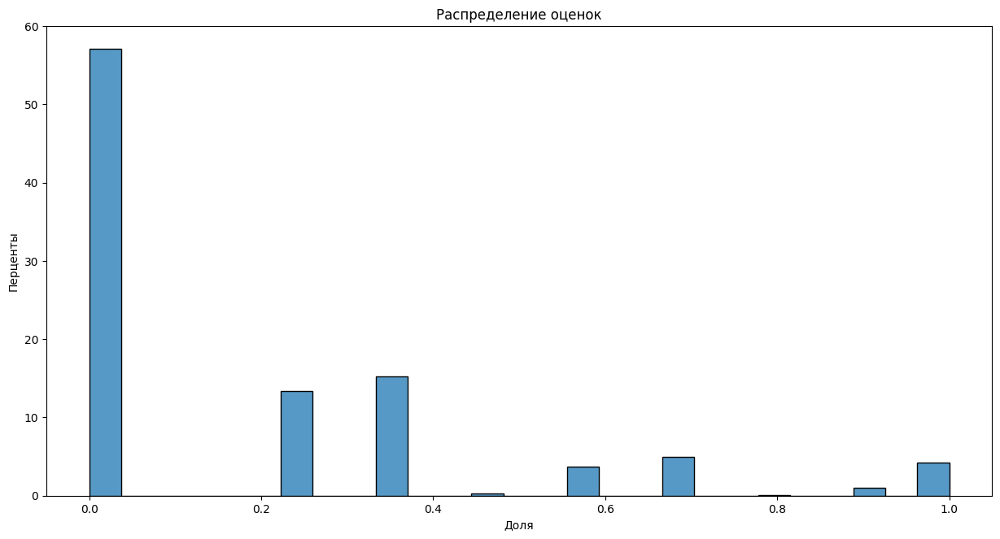

In [32]:
fig, axe = plt.subplots(figsize=(15, 7.5))
sns.histplot(data=merge_train, x=merge_train['evaluations'], stat='percent');
axe.set_title(f'Распределение оценок')
axe.set_xlabel('Доля');
axe.set_ylabel('Перценты');

Мы получили большой дисбаланс между значениями, отличными от нашей цели. Почти 40% значений близки к нулю, а менее 5% близки к единице, что может повлиять на наши результаты.
Мы могли бы ввести некоторые данные, например, все правильные запросы в правильный запрос, и мы могли бы увеличить число значений, равное 1.


## Увеличение данных путем добавления большего значения для цели = 1

Сначала давайте создадим фрейм данных со всеми уникальными запросами и их query_id.

In [33]:
# Генерируем таблицу уникальных query_id-query_text
df_queries = df_train.groupby(['query_id','query_text']).count()
df_queries = df_queries.drop('image', axis=1)
df_queries = df_queries.reset_index().rename_axis(None, axis=1)
df_queries.head()

,query_id,query_text
0,1056338697_4f7d7ce270.jpg#2,"A woman is signaling is to traffic , as seen f..."
1,106490881_5a2dd9b7bd.jpg#2,A young boy in swimming trunks is walking with...
2,1082379191_ec1e53f996.jpg#2,A man and a woman sitting on a dock .
3,1084040636_97d9633581.jpg#2,A white dog has its head on the ground .
4,1096395242_fc69f0ae5a.jpg#2,A young boy with his foot outstretched aims a ...


Тогда присвоим оценку 1 картинке, которой она соответствует. днако перед этим давайте удалим номер идентификатора из нашего query_id.

In [34]:
# Функция для получения изображений по query_id
def strip_query_id(t):
  return t[:-2]

In [35]:
df_queries['image'] = df_queries['query_id']

In [36]:
df_queries['image'] = df_queries['image'].apply(lambda x: strip_query_id(x))

Добавим оценку единицы к объектам df_queries.

In [37]:
df_queries['target'] = 1

In [38]:
merge_all = merge_train.merge(df_queries, how='outer', on=['image', 'query_id', 'query_text'])

In [39]:
merge_all.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6641 entries, 0 to 6640
Data columns (total 5 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   image        6641 non-null   object 
 1   query_id     6641 non-null   object 
 2   query_text   6641 non-null   object 
 3   evaluations  5822 non-null   float64
 4   target       977 non-null    float64
dtypes: float64(2), object(3)
memory usage: 259.5+ KB


Мы получили 977 объектов с оценкой 1. Теперь нам нужно заменить недостающие значения в 'target' значениями из 'evaluations'.

In [40]:
merge_all['target'] = merge_all['target'].fillna(merge_all['evaluations'])

In [41]:
# Удаление столбца 'evaluations'
merge_all = merge_all.drop('evaluations', axis=1)

In [42]:
merge_all.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6641 entries, 0 to 6640
Data columns (total 4 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   image       6641 non-null   object 
 1   query_id    6641 non-null   object 
 2   query_text  6641 non-null   object 
 3   target      6641 non-null   float64
dtypes: float64(1), object(3)
memory usage: 207.7+ KB


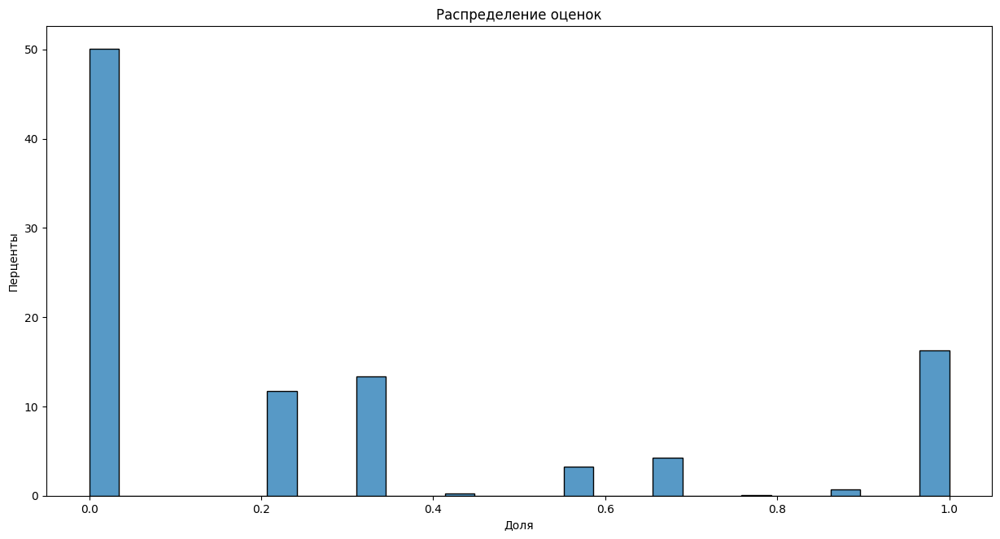

In [43]:
fig, axe = plt.subplots(figsize=(15, 7.5))
sns.histplot(data=merge_all, x=merge_all['target'], stat='percent');
axe.set_title(f'Распределение оценок')
axe.set_xlabel('Доля');
axe.set_ylabel('Перценты');

Мы успешно увеличили наши данные до целевого значения, равного 1.

## Другие целовие поизнаки

У нас есть цеовой признак, который был оценен человеком. Давайте попробуем сгенерировать некоторие оценки с помощью моделей: BLEU score и BERT score.

### BLEU Score

In [44]:
# Переименование текста и изображения запроса столбца для
# создания справочных запросов и справочных изображений.
df_queries = df_queries.rename(columns={'query_text':'reference_query_text', \
                                        'image':'reference_image'})

In [45]:
df_queries.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 977 entries, 0 to 976
Data columns (total 4 columns):
 #   Column                Non-Null Count  Dtype 
---  ------                --------------  ----- 
 0   query_id              977 non-null    object
 1   reference_query_text  977 non-null    object
 2   reference_image       977 non-null    object
 3   target                977 non-null    int64 
dtypes: int64(1), object(3)
memory usage: 30.7+ KB


In [46]:
# удаление столбца query_id, чтобы не связываться со столбцом из merge_all
df_queries = df_queries.drop(['query_id', 'target'], axis=1)

In [47]:
df_queries.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 977 entries, 0 to 976
Data columns (total 2 columns):
 #   Column                Non-Null Count  Dtype 
---  ------                --------------  ----- 
 0   reference_query_text  977 non-null    object
 1   reference_image       977 non-null    object
dtypes: object(2)
memory usage: 15.4+ KB


In [48]:
# Давайте создадим эталонное изображение столбца для merge_all
merge_all['reference_image'] = merge_all['image']

In [49]:
# Давайте объединим запросы df с merge_all
merge_all = merge_all.merge(df_queries, how='inner', on='reference_image')

In [50]:
merge_all.head(15)

,image,query_id,query_text,target,reference_image,reference_query_text
0,1056338697_4f7d7ce270.jpg,1056338697_4f7d7ce270.jpg#2,"A woman is signaling is to traffic , as seen f...",1.000000,1056338697_4f7d7ce270.jpg,"A woman is signaling is to traffic , as seen f..."
1,1056338697_4f7d7ce270.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...,0.000000,1056338697_4f7d7ce270.jpg,"A woman is signaling is to traffic , as seen f..."
2,1056338697_4f7d7ce270.jpg,2718495608_d8533e3ac5.jpg#2,A girl wearing a yellow shirt and sunglasses s...,0.000000,1056338697_4f7d7ce270.jpg,"A woman is signaling is to traffic , as seen f..."
3,1056338697_4f7d7ce270.jpg,3181701312_70a379ab6e.jpg#2,A man sleeps under a blanket on a city street .,0.000000,1056338697_4f7d7ce270.jpg,"A woman is signaling is to traffic , as seen f..."
4,1056338697_4f7d7ce270.jpg,3207358897_bfa61fa3c6.jpg#2,A woman plays with long red ribbons in an empt...,0.222222,1056338697_4f7d7ce270.jpg,"A woman is signaling is to traffic , as seen f..."
5,1056338697_4f7d7ce270.jpg,3286822339_5535af6b93.jpg#2,Chinese market street in the winter time .,0.000000,1056338697_4f7d7ce270.jpg,"A woman is signaling is to traffic , as seen f..."
6,1056338697_4f7d7ce270.jpg,3360930596_1e75164ce6.jpg#2,A soccer ball is above the head of a man weari...,0.000000,1056338697_4f7d7ce270.jpg,"A woman is signaling is to traffic , as seen f..."
7,1056338697_4f7d7ce270.jpg,3545652636_0746537307.jpg#2,A young boy dressed in a red uniform kicks the...,0.000000,1056338697_4f7d7ce270.jpg,"A woman is signaling is to traffic , as seen f..."
8,1056338697_4f7d7ce270.jpg,434792818_56375e203f.jpg#2,A man and woman look back at the camera while ...,0.000000,1056338697_4f7d7ce270.jpg,"A woman is signaling is to traffic , as seen f..."
9,106490881_5a2dd9b7bd.jpg,106490881_5a2dd9b7bd.jpg#2,A young boy in swimming trunks is walking with...,1.000000,106490881_5a2dd9b7bd.jpg,A young boy in swimming trunks is walking with...


In [51]:
# Создание функции трансформатора для токенизации
def data_prep(text):

    # Очистка текста
    clean_text = re.sub(r'[^a-zA-Z\']', ' ', text) # Удаляем все цифры и знаки препинания, кроме '

    # Токенизация
    tweet_tokenizer = TweetTokenizer()
    text_tokenized = tweet_tokenizer.tokenize(clean_text)
    return text_tokenized

In [52]:
# Давайте токенизировать наши запросы
merge_all['reference_query_text_tokenized'] = merge_all['reference_query_text']\
                                                  .apply(lambda x: data_prep(x))
merge_all['query_text_tokenized'] = merge_all['query_text']\
                                                  .apply(lambda x: data_prep(x))

In [53]:
merge_all.head()

,image,query_id,query_text,target,reference_image,reference_query_text,reference_query_text_tokenized,query_text_tokenized
0,1056338697_4f7d7ce270.jpg,1056338697_4f7d7ce270.jpg#2,"A woman is signaling is to traffic , as seen f...",1.000000,1056338697_4f7d7ce270.jpg,"A woman is signaling is to traffic , as seen f...","[A, woman, is, signaling, is, to, traffic, as,...","[A, woman, is, signaling, is, to, traffic, as,..."
1,1056338697_4f7d7ce270.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...,0.000000,1056338697_4f7d7ce270.jpg,"A woman is signaling is to traffic , as seen f...","[A, woman, is, signaling, is, to, traffic, as,...","[A, young, child, is, wearing, blue, goggles, ..."
2,1056338697_4f7d7ce270.jpg,2718495608_d8533e3ac5.jpg#2,A girl wearing a yellow shirt and sunglasses s...,0.000000,1056338697_4f7d7ce270.jpg,"A woman is signaling is to traffic , as seen f...","[A, woman, is, signaling, is, to, traffic, as,...","[A, girl, wearing, a, yellow, shirt, and, sung..."
3,1056338697_4f7d7ce270.jpg,3181701312_70a379ab6e.jpg#2,A man sleeps under a blanket on a city street .,0.000000,1056338697_4f7d7ce270.jpg,"A woman is signaling is to traffic , as seen f...","[A, woman, is, signaling, is, to, traffic, as,...","[A, man, sleeps, under, a, blanket, on, a, cit..."
4,1056338697_4f7d7ce270.jpg,3207358897_bfa61fa3c6.jpg#2,A woman plays with long red ribbons in an empt...,0.222222,1056338697_4f7d7ce270.jpg,"A woman is signaling is to traffic , as seen f...","[A, woman, is, signaling, is, to, traffic, as,...","[A, woman, plays, with, long, red, ribbons, in..."


Токенизация сработала!

In [54]:
def bleu_score(row):
  weights = (1.0, 0., 0., 0.)
  score = sentence_bleu([row['reference_query_text_tokenized']], \
                        row['query_text_tokenized'],\
                        weights=weights)
  return round(score, 3)

merge_all['bleu_score'] = merge_all.apply(bleu_score, axis=1)

In [55]:
pd.set_option('display.max_columns', None)
merge_all.head(15)

,image,query_id,query_text,target,reference_image,reference_query_text,reference_query_text_tokenized,query_text_tokenized,bleu_score
0,1056338697_4f7d7ce270.jpg,1056338697_4f7d7ce270.jpg#2,"A woman is signaling is to traffic , as seen f...",1.000000,1056338697_4f7d7ce270.jpg,"A woman is signaling is to traffic , as seen f...","[A, woman, is, signaling, is, to, traffic, as,...","[A, woman, is, signaling, is, to, traffic, as,...",1.000
1,1056338697_4f7d7ce270.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...,0.000000,1056338697_4f7d7ce270.jpg,"A woman is signaling is to traffic , as seen f...","[A, woman, is, signaling, is, to, traffic, as,...","[A, young, child, is, wearing, blue, goggles, ...",0.133
2,1056338697_4f7d7ce270.jpg,2718495608_d8533e3ac5.jpg#2,A girl wearing a yellow shirt and sunglasses s...,0.000000,1056338697_4f7d7ce270.jpg,"A woman is signaling is to traffic , as seen f...","[A, woman, is, signaling, is, to, traffic, as,...","[A, girl, wearing, a, yellow, shirt, and, sung...",0.089
3,1056338697_4f7d7ce270.jpg,3181701312_70a379ab6e.jpg#2,A man sleeps under a blanket on a city street .,0.000000,1056338697_4f7d7ce270.jpg,"A woman is signaling is to traffic , as seen f...","[A, woman, is, signaling, is, to, traffic, as,...","[A, man, sleeps, under, a, blanket, on, a, cit...",0.090
4,1056338697_4f7d7ce270.jpg,3207358897_bfa61fa3c6.jpg#2,A woman plays with long red ribbons in an empt...,0.222222,1056338697_4f7d7ce270.jpg,"A woman is signaling is to traffic , as seen f...","[A, woman, is, signaling, is, to, traffic, as,...","[A, woman, plays, with, long, red, ribbons, in...",0.182
5,1056338697_4f7d7ce270.jpg,3286822339_5535af6b93.jpg#2,Chinese market street in the winter time .,0.000000,1056338697_4f7d7ce270.jpg,"A woman is signaling is to traffic , as seen f...","[A, woman, is, signaling, is, to, traffic, as,...","[Chinese, market, street, in, the, winter, time]",0.000
6,1056338697_4f7d7ce270.jpg,3360930596_1e75164ce6.jpg#2,A soccer ball is above the head of a man weari...,0.000000,1056338697_4f7d7ce270.jpg,"A woman is signaling is to traffic , as seen f...","[A, woman, is, signaling, is, to, traffic, as,...","[A, soccer, ball, is, above, the, head, of, a,...",0.105
7,1056338697_4f7d7ce270.jpg,3545652636_0746537307.jpg#2,A young boy dressed in a red uniform kicks the...,0.000000,1056338697_4f7d7ce270.jpg,"A woman is signaling is to traffic , as seen f...","[A, woman, is, signaling, is, to, traffic, as,...","[A, young, boy, dressed, in, a, red, uniform, ...",0.174
8,1056338697_4f7d7ce270.jpg,434792818_56375e203f.jpg#2,A man and woman look back at the camera while ...,0.000000,1056338697_4f7d7ce270.jpg,"A woman is signaling is to traffic , as seen f...","[A, woman, is, signaling, is, to, traffic, as,...","[A, man, and, woman, look, back, at, the, came...",0.111
9,106490881_5a2dd9b7bd.jpg,106490881_5a2dd9b7bd.jpg#2,A young boy in swimming trunks is walking with...,1.000000,106490881_5a2dd9b7bd.jpg,A young boy in swimming trunks is walking with...,"[A, young, boy, in, swimming, trunks, is, walk...","[A, young, boy, in, swimming, trunks, is, walk...",1.000


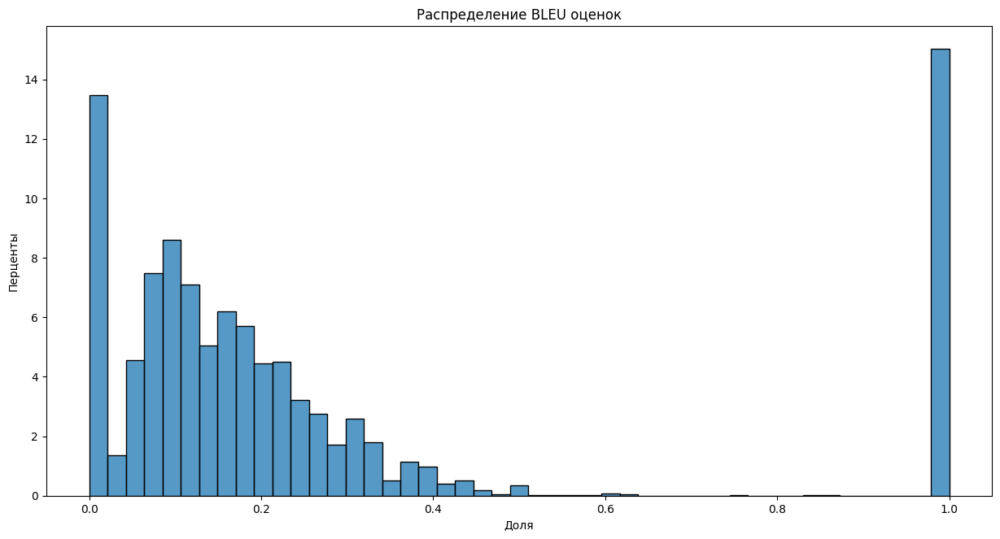

In [56]:
fig, axe = plt.subplots(figsize=(15, 7.5))
sns.histplot(data=merge_all, x=merge_all['bleu_score'], stat='percent');
axe.set_title(f'Распределение BLEU оценок')
axe.set_xlabel('Доля');
axe.set_ylabel('Перценты');

Мы получили что-то близкое к тому, что получили при оценке людей.

### BERT Score

In [57]:
# Давайте создадим оценку BERT усреднения F1_score
notebook.tqdm.pandas(desc='Progression...')
scorer = BERTScorer(model_type='bert-base-uncased')
def bert_score(row):
  P, R, F1 = scorer.score([row['query_text']], [row['reference_query_text']])
  #print(f"BERTScore Precision: {P.mean():.4f}, Recall: {R.mean():.4f}, F1: {F1.mean():.4f}")
  return F1.mean().item()

merge_all['bert_score'] = merge_all.progress_apply(bert_score, axis=1)

Progression...:   0%|          | 0/6498 [00:00<?, ?it/s]

In [58]:
merge_all.head(15)

,image,query_id,query_text,target,reference_image,reference_query_text,reference_query_text_tokenized,query_text_tokenized,bleu_score,bert_score
0,1056338697_4f7d7ce270.jpg,1056338697_4f7d7ce270.jpg#2,"A woman is signaling is to traffic , as seen f...",1.000000,1056338697_4f7d7ce270.jpg,"A woman is signaling is to traffic , as seen f...","[A, woman, is, signaling, is, to, traffic, as,...","[A, woman, is, signaling, is, to, traffic, as,...",1.000,1.000000
1,1056338697_4f7d7ce270.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...,0.000000,1056338697_4f7d7ce270.jpg,"A woman is signaling is to traffic , as seen f...","[A, woman, is, signaling, is, to, traffic, as,...","[A, young, child, is, wearing, blue, goggles, ...",0.133,0.508533
2,1056338697_4f7d7ce270.jpg,2718495608_d8533e3ac5.jpg#2,A girl wearing a yellow shirt and sunglasses s...,0.000000,1056338697_4f7d7ce270.jpg,"A woman is signaling is to traffic , as seen f...","[A, woman, is, signaling, is, to, traffic, as,...","[A, girl, wearing, a, yellow, shirt, and, sung...",0.089,0.478396
3,1056338697_4f7d7ce270.jpg,3181701312_70a379ab6e.jpg#2,A man sleeps under a blanket on a city street .,0.000000,1056338697_4f7d7ce270.jpg,"A woman is signaling is to traffic , as seen f...","[A, woman, is, signaling, is, to, traffic, as,...","[A, man, sleeps, under, a, blanket, on, a, cit...",0.090,0.501893
4,1056338697_4f7d7ce270.jpg,3207358897_bfa61fa3c6.jpg#2,A woman plays with long red ribbons in an empt...,0.222222,1056338697_4f7d7ce270.jpg,"A woman is signaling is to traffic , as seen f...","[A, woman, is, signaling, is, to, traffic, as,...","[A, woman, plays, with, long, red, ribbons, in...",0.182,0.513025
5,1056338697_4f7d7ce270.jpg,3286822339_5535af6b93.jpg#2,Chinese market street in the winter time .,0.000000,1056338697_4f7d7ce270.jpg,"A woman is signaling is to traffic , as seen f...","[A, woman, is, signaling, is, to, traffic, as,...","[Chinese, market, street, in, the, winter, time]",0.000,0.410256
6,1056338697_4f7d7ce270.jpg,3360930596_1e75164ce6.jpg#2,A soccer ball is above the head of a man weari...,0.000000,1056338697_4f7d7ce270.jpg,"A woman is signaling is to traffic , as seen f...","[A, woman, is, signaling, is, to, traffic, as,...","[A, soccer, ball, is, above, the, head, of, a,...",0.105,0.474666
7,1056338697_4f7d7ce270.jpg,3545652636_0746537307.jpg#2,A young boy dressed in a red uniform kicks the...,0.000000,1056338697_4f7d7ce270.jpg,"A woman is signaling is to traffic , as seen f...","[A, woman, is, signaling, is, to, traffic, as,...","[A, young, boy, dressed, in, a, red, uniform, ...",0.174,0.526080
8,1056338697_4f7d7ce270.jpg,434792818_56375e203f.jpg#2,A man and woman look back at the camera while ...,0.000000,1056338697_4f7d7ce270.jpg,"A woman is signaling is to traffic , as seen f...","[A, woman, is, signaling, is, to, traffic, as,...","[A, man, and, woman, look, back, at, the, came...",0.111,0.521319
9,106490881_5a2dd9b7bd.jpg,106490881_5a2dd9b7bd.jpg#2,A young boy in swimming trunks is walking with...,1.000000,106490881_5a2dd9b7bd.jpg,A young boy in swimming trunks is walking with...,"[A, young, boy, in, swimming, trunks, is, walk...","[A, young, boy, in, swimming, trunks, is, walk...",1.000,1.000000


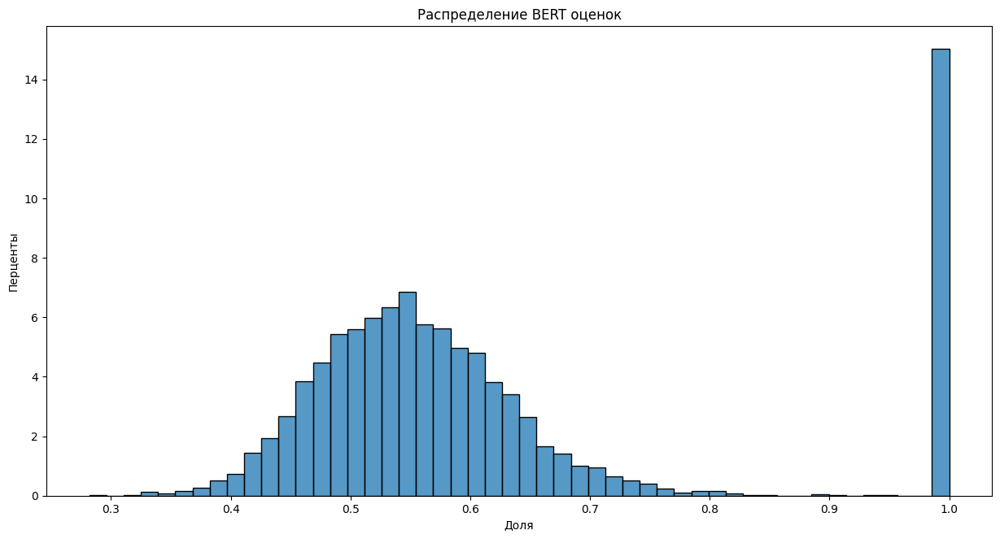

In [59]:
fig, axe = plt.subplots(figsize=(15, 7.5))
sns.histplot(data=merge_all, x=merge_all['bert_score'], stat='percent');
axe.set_title(f'Распределение BERT оценок')
axe.set_xlabel('Доля');
axe.set_ylabel('Перценты');

За исключением всех объектов, у которых балл равен единице, все остальные значения приняли нормальное распределение около 0,55.

Мы собираемся протестировать некоторые модели с оценкой BERT.

## Распределение количества слов в подзапросе

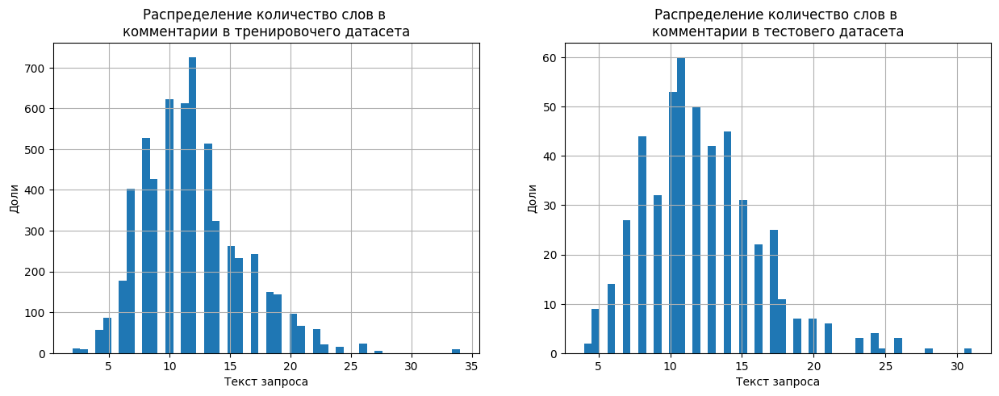

In [60]:
fig, axe = plt.subplots(nrows=1, ncols=2, figsize=(15, 5))

dataframes = [df_train['query_text'], df_test['query_text']]
name = ['тренировочего датасета', 'тестовего датасета']

for index, dataframe in enumerate(dataframes):

    dataframe.apply(lambda x : len(x.split())).hist(bins=50, ax=axe[index])
    axe[index].set_title(f'Распределение количество слов в \n'
                     f'комментарии в {name[index]}')
    axe[index].set_xlabel('Текст запроса');
    axe[index].set_ylabel('Доли');

We see that the query test got about the same distribution in both dataframe. Only one caption has more than 30 words. Those query text average less than 15 words.\
Мы видим, что распределенние запросов получил примерно одинаковое распределение в обоих датасете. Только одна подпись содержит более 30 слов. Текст запроса в среднем содержит менее 15 слов.

## Сортировка датафрейма по имени изображения

In [61]:
# Удаление столбцов, которые нам больше не нужны
merge_all = merge_all.drop(['reference_image', 'reference_query_text', \
                                  'reference_query_text_tokenized', \
                                  'query_text_tokenized', 'bleu_score'], axis=1)

In [62]:
merge_all = merge_all.sort_values(by='image')

In [63]:
merge_all.head(10)

,image,query_id,query_text,target,bert_score
0,1056338697_4f7d7ce270.jpg,1056338697_4f7d7ce270.jpg#2,"A woman is signaling is to traffic , as seen f...",1.000000,1.000000
1,1056338697_4f7d7ce270.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...,0.000000,0.508533
2,1056338697_4f7d7ce270.jpg,2718495608_d8533e3ac5.jpg#2,A girl wearing a yellow shirt and sunglasses s...,0.000000,0.478396
3,1056338697_4f7d7ce270.jpg,3181701312_70a379ab6e.jpg#2,A man sleeps under a blanket on a city street .,0.000000,0.501893
4,1056338697_4f7d7ce270.jpg,3207358897_bfa61fa3c6.jpg#2,A woman plays with long red ribbons in an empt...,0.222222,0.513025
5,1056338697_4f7d7ce270.jpg,3286822339_5535af6b93.jpg#2,Chinese market street in the winter time .,0.000000,0.410256
6,1056338697_4f7d7ce270.jpg,3360930596_1e75164ce6.jpg#2,A soccer ball is above the head of a man weari...,0.000000,0.474666
7,1056338697_4f7d7ce270.jpg,3545652636_0746537307.jpg#2,A young boy dressed in a red uniform kicks the...,0.000000,0.526080
8,1056338697_4f7d7ce270.jpg,434792818_56375e203f.jpg#2,A man and woman look back at the camera while ...,0.000000,0.521319
17,106490881_5a2dd9b7bd.jpg,493621130_152bdd4e91.jpg#2,A dog wearing a collar jumping from a platform .,0.000000,0.564964


## Вывод

Во время EDA мы заметили, что даже если у нас и были промежуточные значения оценок экспертов, большинство из них все равно были близки к 0 или в очень небольшом количестве.

Объектов для оценок, равных 1, было в очень небольшом количестве. Мы решили увеличить количество объектов, равное 1, создав пару «изображение-запрос» с запросом самого изображения, зная, что это наиболее подходящая подпись. Таким образом, значение целовой признак в этом случае будет равно 1.

Мы также получили BLEU оценку и BERT оценку. Оценка BLEU имела такое же распределение, как и оценка человека. Тем не менее, показатель BERT имеет распределение, похожее на нормальное распределение, если мы не учитываем значение 1.

Мы собираемся обучить нашу модель с помощью оценки человека ('target'), а также BERT оценки, просто чтобы посмотреть, какую разницу это может иметь.

# Подготовка данные к обучению модели

## Проверка данных

### Извлечение информации для удаления детских фотографий

In order to respect the law we are going to remove all the picture mentionning the word list below. We are aware that for example 'girl' or 'teenager' may mention a person older than 16, however to be sure that we do not break the law we are going to remove those pictures from the dataframe.

From the list of queries that we studied earlier in the report (list_query_text_train) we have been able to spote some words which my helpe us to delete children pictures

### Рассматривание детских фотографий

In [64]:
# Слова, которые помогут найти детские картинки в тексте_запроса
list_words = ['boy', 'girl', 'child', 'children', 'kid', 'kids', 'toddler', 'teenager', 'students', 'babies', 'baby']

In [65]:
# Функция для обнаружения объекта, дочерние элементы которого упоминаются в query_text
def spotting_children_pictures(t):
  if re.findall(r'(boy)|( girl)|(child)|(children)|(kid)|(kids)|(toddler)|(teenager)|(students)|(babies)|(baby)',\
                t, re.IGNORECASE):
    return 1
  else:
    return 0

In [66]:
# Применение spotting_children_pictures and strip_query_id к набору тестовых данных
merge_all['to_delete'] = merge_all['query_text'].apply(lambda x: spotting_children_pictures(x))
merge_all['strip_query_id'] = merge_all['query_id'].apply(lambda x: strip_query_id(x))

In [67]:
# Создание списка изображений, которые нам придется удалить из набора данных
images_to_remove_train = list(set(merge_all.\
                                  query('to_delete == 1')['strip_query_id'].to_list()))
print(f'Есть {len(images_to_remove_train)} изображения для удаления из набора обучающих датасетов.')

Есть 291 изображения для удаления из набора обучающих датасетов.


### Удаление детских фотографий из наборов данных

In [68]:
# Новый набор обучающих данных не содержит детских изображений
df_train_prep = merge_all.query('image != @images_to_remove_train')\
                        .reset_index(drop=True)\
                        .drop(['to_delete', 'strip_query_id'], axis=1)

In [69]:
df_train_prep.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4508 entries, 0 to 4507
Data columns (total 5 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   image       4508 non-null   object 
 1   query_id    4508 non-null   object 
 2   query_text  4508 non-null   object 
 3   target      4508 non-null   float64
 4   bert_score  4508 non-null   float64
dtypes: float64(2), object(3)
memory usage: 176.2+ KB


In [70]:
print(f'Our training dataset now contains only {len(df_train_prep)} objects.')

Our training dataset now contains only 4508 objects.


In [71]:
df_images_only = df_train_prep[['image']].drop_duplicates().reset_index(drop=True)

In [72]:
df_query_only = pd.DataFrame(df_train_prep['query_text'].unique(), columns=['query_text'])

### Проверка наличия детских картинок в наборе

In [73]:
# Создание списка всех разрешенных изображений
list_images = df_images_only['image'].value_counts().index.to_list()
list_images[:5]

['1056338697_4f7d7ce270.jpg',
 '3384314832_dffc944152.jpg',
 '3360930596_1e75164ce6.jpg',
 '3361990489_92244a58ef.jpg',
 '3363750526_efcedc47a9.jpg']

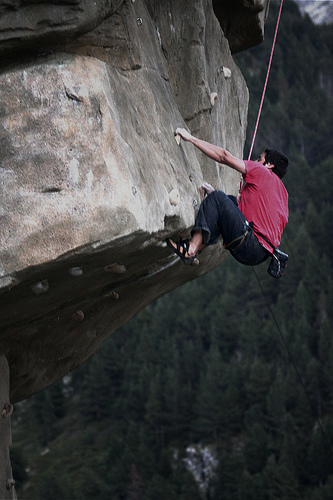

,query_text,target,bert_score
4499,A person wearing a white hat climbs a rock .,0.666667,0.745766
4500,A man pulls on his sweater as a kayak lays at ...,0.000000,0.518749
4501,a motorcyclist wearing a red and white jacket ...,0.000000,0.608854
4502,Two greyhounds race .,0.000000,0.424172
4503,People trackside at a subway station by a train .,0.000000,0.518447
4504,A man sitting on a subway .,0.000000,0.610269
4505,A man wearing a red hat looks down as another ...,0.000000,0.554542
4506,A white birds lands swiftly in the water .,0.000000,0.481483
4507,A person in a red shirt climbing up a rock fac...,1.000000,1.000000


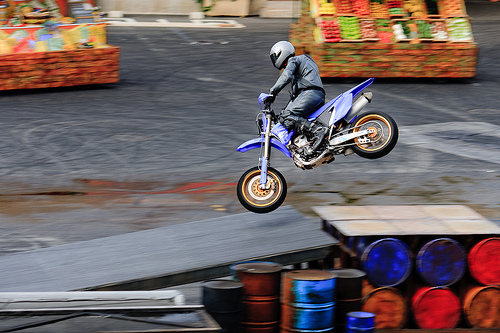

,query_text,target,bert_score
1717,A group of people walking a city street in war...,0.000000,0.570856
1718,A man riding a motorcycle is performing a tric...,0.888889,0.764342
1719,A man riding a blue motorcycle jumps over a ra...,1.000000,1.000000
1720,A sports car with flames coming out the exhaust .,0.000000,0.526720
1721,Boat number 5 has several men with life jacket...,0.000000,0.535016
1722,a red and white race car racing on a dirt race...,0.000000,0.611835
1723,A white dog is running on gravel away from two...,0.000000,0.608917


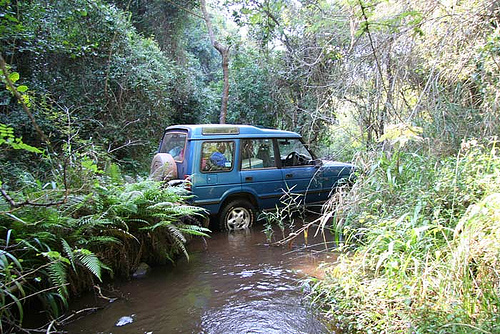

,query_text,target,bert_score
1555,A grey dog walks on top of a fallen tree in th...,0.000000,0.693517
1556,A young girl standing in front of a fountain,0.000000,0.555527
1557,A blue SUV drives in a stream surrounded by wo...,1.000000,1.000000
1558,A man wearing red shorts is holding onto the r...,0.000000,0.588028
1559,A man scales a rock in the forest .,0.222222,0.646674


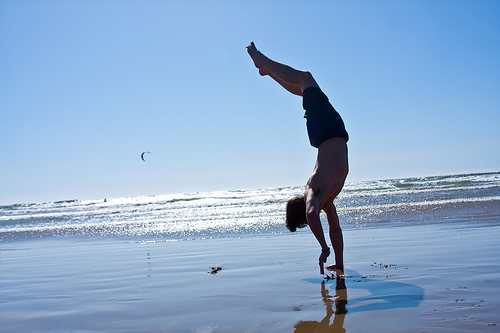

,query_text,target,bert_score
3062,Man fly fishing in a small river with steam in...,0.222222,0.579214
3063,A sunset sky over rippling water .,0.333333,0.472351
3064,Team members being lifted up high to catch a f...,0.000000,0.503037
3065,A man is performing a handstand on the beach .,1.000000,1.000000
3066,A mist overshadows a man in winter gear and th...,0.000000,0.503891


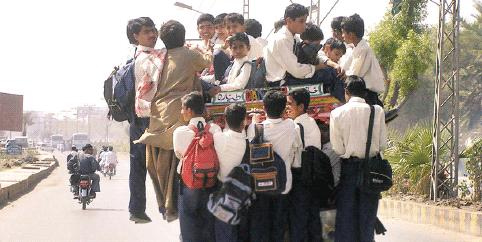

,query_text,target,bert_score
817,almost 2 dozen people are riding on the outsid...,1.000000,1.000000
818,People stand outside a house .,0.222222,0.576488
819,A raft hanging from a rope over the ocean .,0.000000,0.485083
820,A group of five adults stand posing in front o...,0.000000,0.576752
821,A person on a ladder with a baby underneath .,0.000000,0.489007


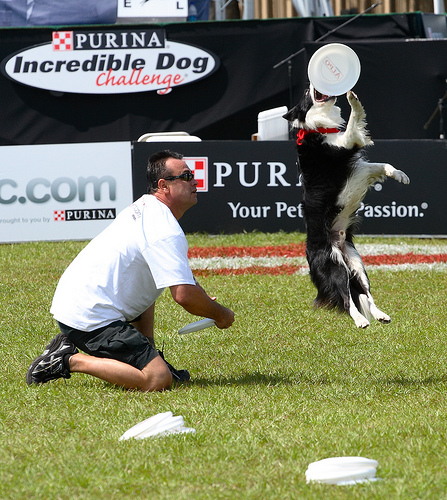

,query_text,target,bert_score
1009,a woman wearing a black and white outfit while...,0.000000,0.363482
1010,A gray dog sits on a lawn wearing a bright blu...,0.000000,0.455782
1011,A man rides a bike through a course .,0.000000,0.516147
1012,A black and white dog prepares to catch a Fris...,1.000000,0.664185
1013,A dog jumps for a Frisbee at the Purina Incred...,1.000000,1.000000
1014,Men playing soccer in a field,0.222222,0.385103


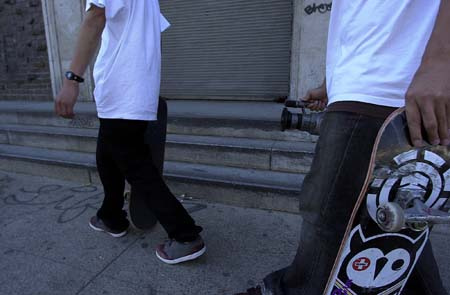

,query_text,target,bert_score
368,A person in skis is jumping off the side of a ...,0.222222,0.468268
369,A man is holding up a small poster with two pe...,0.000000,0.518900
370,A skateboarder is performing a trick in the air .,0.333333,0.521820
371,A young man shocks the audience with his skate...,0.333333,0.508936
372,A woman holding a black leash and a man lookin...,0.000000,0.580698
373,"Two guys walking , one carrying a skateboard",1.000000,1.000000
374,"An asian man in a suit on the subway , asleep .",0.000000,0.515772
375,A girl in jeans tries to show an adult how hig...,0.000000,0.425072


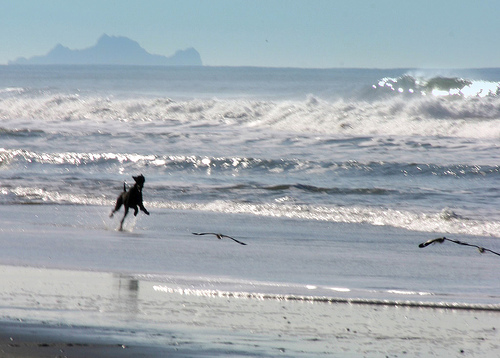

,query_text,target,bert_score
3041,A dog is running along the beach beside the oc...,1.0,1.000000
3042,A man at a rodeo is thrown off a horse .,0.0,0.544407
3043,a dog on the beach .,1.0,0.745442


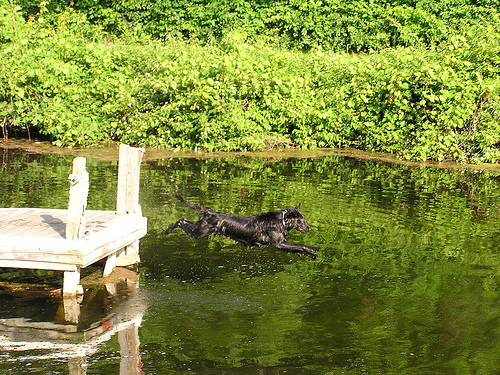

,query_text,target,bert_score
1294,A grey dog walks on top of a fallen tree in th...,0.333333,0.711777
1295,A man is hiking on a snow-covered trail .,0.000000,0.612661
1296,A little girl in a white shirt sliding down a ...,0.000000,0.588061
1297,A black dog jumps into the water off a dock .,1.000000,1.000000
1298,Two dogs in motion in a grassy field with smal...,0.222222,0.559094
1299,A brown dog hops over a fallen tree branch .,0.555556,0.747897


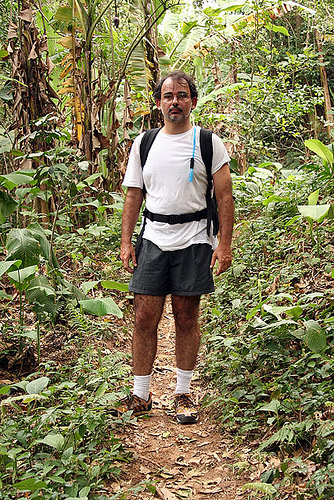

,query_text,target,bert_score
919,A dog with a ball in his mouth running down a ...,0.000000,0.608381
920,A brown dog sitting on grass,0.000000,0.543708
921,A woman wears sunglasses and a black coat as s...,0.000000,0.582542
922,A man wearing a water pack and shorts on an ou...,1.000000,1.000000
923,A small brown and white dog running through ta...,0.000000,0.564087
924,A smaller art festival on the edge of a forest,0.333333,0.511375


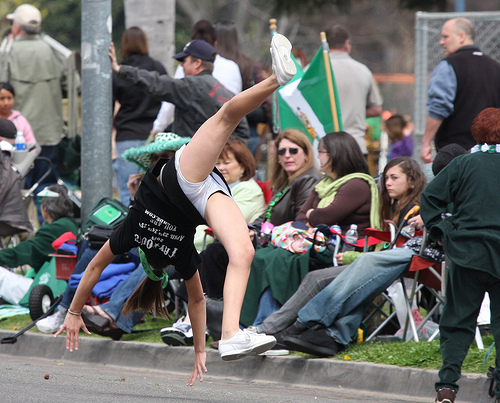

,query_text,target,bert_score
2966,The girls were in the crowd .,0.222222,0.558326
2967,"A young , fit man wearing short does a high ri...",0.222222,0.570210
2968,A little boy preparing to hit a baseball,0.000000,0.476383
2969,A group of men are playing rugby .,0.000000,0.575880
2970,A man in a green and silver Mardi Gras costume...,0.000000,0.486792
2971,A woman is doing a backwards flip in front of ...,1.000000,1.000000


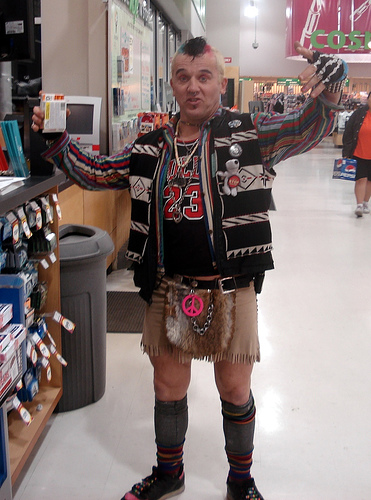

,query_text,target,bert_score
3838,A person in a kilt and a sports jersey and a M...,1.000000,1.000000
3839,A crowd of people at an outdoor event,0.000000,0.481121
3840,People stand outside a house .,0.222222,0.565679
3841,A man wearing an orange cap sits on a white be...,0.222222,0.574237
3842,Chinese market street in the winter time .,0.000000,0.435927
3843,Men walk down a street with skyscrapers in the...,0.333333,0.505858


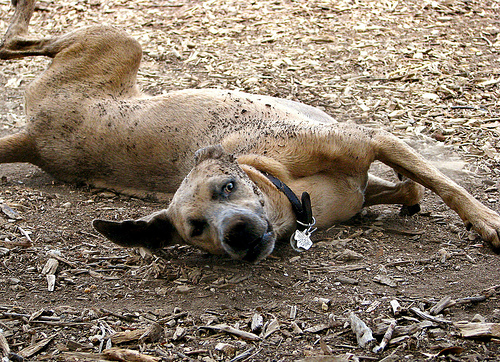

,query_text,target,bert_score
1420,A dog with a ball in his mouth running down a ...,0.222222,0.584767
1421,A dog rolls on the ground .,1.000000,1.000000
1422,A white and black dog is jumping in the air tr...,0.333333,0.646985
1423,A child hanging from a hay bale loader .,0.000000,0.553179
1424,A smiling child sits against a wall on a blank...,0.000000,0.636636
1425,A person drives an ATV through mud .,0.000000,0.634079


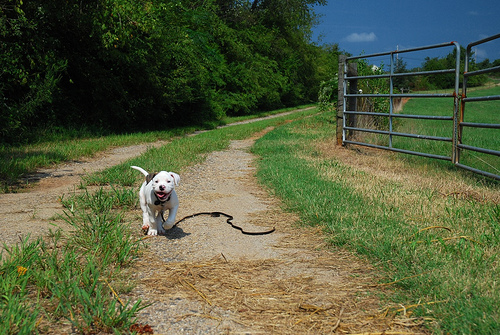

,query_text,target,bert_score
1547,An individual rappelling down a cliff towards ...,0.000000,0.505887
1548,Two dogs bound across the grass .,0.222222,0.662033
1549,Dog running towards camera with a ball in its ...,0.555556,0.548811
1550,"A white dog runs along a path , trailing a lea...",1.000000,1.000000
1551,A man riding a brown horse poses in front of a...,0.000000,0.606124
1552,"Three black dogs , two with tan markings , are...",0.555556,0.628936
1553,Two dogs run down a dirt path in the forest .,0.333333,0.705430
1554,A man points his finger to the path ahead as h...,0.222222,0.546284


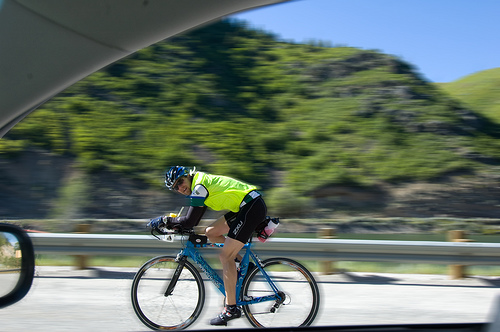

,query_text,target,bert_score
3314,A woman riding a bike in a park,0.555556,0.540601
3315,Boys in life jackets on a watercraft .,0.000000,0.529653
3316,Dark colored Mercury car parked in front of PN...,0.000000,0.441419
3317,Two men and a woman smile at the camera .,0.000000,0.433114
3318,A cyclist in a helmet and yellow jersey .,1.000000,1.000000
3319,A young boy is riding a bike .,0.555556,0.541112
3320,A person wearing a red and white uniform is ra...,0.222222,0.618694
3321,Collie jumping over a training hurdle that is ...,0.000000,0.476329


<Figure size 2000x2000 with 0 Axes>

In [74]:
fig = plt.figure(figsize=(20,20));
for i in range(15):
    # Генерация случайного целого числа
    rand_n = random.randint(0, len(list_images))
    # Получаем имя изображения, выбранного из list_images
    img_name = list_images[rand_n]
    # Получение изображения из папки
    img = Image.open(os.path.join(DATA_PATH,'train_images/',list_images[rand_n]))
    # Отображение изображения
    display(img);
    # Отображение части датафреймы, связанной с изображением
    display(df_train_prep.query("image == @img_name")[['query_text','target', 'bert_score']]);


Мы видим, что в нашем наборе данных больше не видим детских изображений.

Мы также заметили, что все изображения имеют разные размеры, что потребует предварительной обработки, но все они имеют правильную ориентацию, ни одно изображение не повернуто.

In [75]:
# Удаление датафреймы, которие нам больше не нужен
del df_crowd_notation
del merge_train_experts
del scorer

## Векторизация изображений

### Resnet архитектура

In [76]:
# Загрузка модель Resnet50
resnet = models.resnet18(pretrained=True) #загружаем претренированную модель

In [77]:
# Заморозим веса
for param in resnet.parameters():
    param.requires_grad_(False)

In [78]:
# Отображение архитектуры resnet50
print(list(resnet.children()))

[Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False), BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True), ReLU(inplace=True), MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False), Sequential(
  (0): BasicBlock(
    (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU(inplace=True)
    (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (1): BasicBlock(
    (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU(inplace=True)
    (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bia

In [79]:
# Чтобы извлечь вектор из изображения, нам нужно использовать все слои, кроме двух последних (только последнние здесь).
modules = list(resnet.children())[:-1]
resnet = nn.Sequential(*modules)

Предполагается, что мы заморозим последние два слоя. Однако, заморозив только последний для resnet50, я получил лучший результат и уменьшенный размер выходного вектора.

In [80]:
# Для предсказываннии
resnet.eval()

Sequential(
  (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (2): ReLU(inplace=True)
  (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (4): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Con

### Создание функции векторизации зображеннии

In [81]:
# Предварительная обработка изображения и нормализация
def image_prep(image):
  # Нормализация картинки
  norm = transforms.Normalize(
        mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
  # Предварительная обработка изображения
  preprocess = transforms.Compose([
      transforms.Resize(256),
      transforms.CenterCrop(224),
      transforms.ToTensor(),
      norm,
        ])

  return preprocess(image)

In [82]:
# Функция векторизации изображения
# Здесь batch_size должен быть равен 1, чтобы получить исходный кадр данных.

def image_vectorization(folder, column_name_image, batch_size):

  list_batch_tensor_flat = []

  for i in notebook.tqdm(range(0, len(column_name_image), batch_size)): # Прокручиваем датафрейм для каждого бача
    batch_image_tensor = []

    for image in column_name_image[i:i+batch_size]: 

        img = Image.open(os.path.join(DATA_PATH,f'{folder}/', str(image))).convert('RGB')

        image_tensor = image_prep(img) # Предварительная обработка изображения

        batch_image_tensor.append(image_tensor) # Добавить бач в список бачов

    batch_tensor = torch.stack(batch_image_tensor) # сложите тензоры каждой бачи вместе

    batch_tensor_flat = resnet(batch_tensor).flatten() # сгладить сложенный тензор из бача

    list_batch_tensor_flat.append(batch_tensor_flat) # Добавить в список весь сплющенный тензор каждой бачи

  if len(batch_image_tensor) == batch_size:
    vectorized_images = torch.stack(list_batch_tensor_flat) # наложение тензоров друг на друга
  else:
    #  наложение тензоров друг на друга без последнего бача если количество изображеных меньше, чем размер бача
    vectorized_images = torch.stack(list_batch_tensor_flat[:-1])

  return vectorized_images # возвращение результирующего тензора

### Генерация вектор изображений

Несмотря на то, что набор обучающих данных содержит много объектов, эти объекты связаны только с определенным количеством изображений. Вместо того, чтобы тратить много времени на векторизацию всех изображений объекта датафрейма, мы собираемся векторизовать только те изображение, которое нам нужно, и потом объединить датафрейм с новыми признаками с набором обучающих данных.

In [83]:
vectorized_images = image_vectorization('train_images', df_train_prep['image'], 1).numpy()

  0%|          | 0/4508 [00:00<?, ?it/s]

In [84]:
#vectorized_images.size()
vectorized_images.shape

(4508, 512)

Тензор, который мы получили, имеет размер (4508, 512). 4508 объектов и 512 описывающих их признаков.

## Векторизация текстов

### Загрузка предварительно обученной модели Берта

In [85]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [86]:
# Загрузка токенизатора и модели BERT
tokenizer = BertTokenizer.from_pretrained('bert-base-uncased')
bert = BertModel.from_pretrained('bert-base-uncased').to(device)

### Создание функции векторизации текстов

In [87]:
# Функция векторизации текста
def text_vectorization_only(text, batch_size):

    vector = tokenizer.encode(text, add_special_tokens=True)
    n = 16
    padded = np.array(vector + [0]*(n - len(vector)))
    attention_mask = np.where(padded != 0, 1, 0)

    for i in range(padded.shape[0] // batch_size):
        batch = torch.LongTensor(padded[batch_size*i:batch_size*(i+1)]).to(device)
        attention_mask_batch = torch.LongTensor(attention_mask[batch_size*i:batch_size*(i+1)])

    # Embedding текста
    with torch.no_grad():
        batch_embeddings = bert(torch.unsqueeze(batch, 0).to(device), \
                                    attention_mask=torch.unsqueeze(attention_mask_batch, 0).to(device))
    return batch_embeddings[0][:,0,:].cpu().numpy()

In [88]:
# Функция векторизации текстов
def text_vectorization(dataframe, batch_size):
    embeddings = []
    for i in notebook.tqdm(range(0, len(dataframe), 1)):
        res_vect = text_vectorization_only(dataframe.loc[i, 'query_text'], batch_size)
        embeddings.append(res_vect)
    return embeddings


### Генерация вектор текстов

In [89]:
list_vectorized_texts = text_vectorization(df_train_prep, 1)

  0%|          | 0/4508 [00:00<?, ?it/s]

In [90]:
vectorized_texts = np.concatenate(list_vectorized_texts)

Как и раньше, мы не будем применять всю функцию ко всему датафрейму, а только к нашу 965 тексту запроса.

In [91]:
vectorized_texts.shape

(4508, 768)

Тензор, который мы получили, имеет размер (4508, 768). 4508 объектов и 768 описывающих их признаков.

## Объединение векторов

In [92]:
# Объединение векторов
unified_vector = np.concatenate((vectorized_images, vectorized_texts), axis=1)

In [93]:
# Размер объединение векторов
unified_vector.shape

(4508, 1280)

## Вывод

Нам удалось удалить детские изображения из набора данных.

Нам также удалось создать вектор векторизованных изображений и вектор векторизованных текстов.

В конце мы получили вектор с размерой : (4508, 1280). 

# Обученние модели

## Метрика регрессии

Мы собираемся использовать метрику MAE, поскольку ее легче всего интерпретировать, мы всегда можем сравнить результат со средним целевым значением в качестве базового уровня.

## Групповая утечка

Чтобы избежать утечки групп, мы будем использовать метод groupshufflesplit для перекрестной проверки.

In [94]:
# Отделяем наш целвое переменое от набора обучающих данных
X = pd.DataFrame(unified_vector, columns=['f_' + str(i) \
                                             for i in range(0, unified_vector.shape[1])])
y = df_train_prep['target']

In [95]:
# Разделение нашего набора обучающих и тестовых данных для валидации

RANDOM_STATE = 42

gss = GroupShuffleSplit(n_splits=1, train_size=.7, random_state=RANDOM_STATE)

train_indices, val_indices = next(gss.split(X= X,\
                                             y=df_train_prep['target'],\
                                             groups=df_train_prep['image']))
train_df, val_df = X.loc[train_indices], X.loc[val_indices]
train_target, val_target = df_train_prep.loc[train_indices, 'target'], \
                                                        df_train_prep.loc[val_indices, 'target']

## Модели для обучении

Мы собираемся обучить разные модель :
- ElasticNet()
- RandomForestRegressor()
- SVRegressor()
- DummyRegressor() сравнить результат нашей модели

### Обучение модели и оценка на валидационные датасете (оценка человека в качестве целвой признак)

#### ElasticNet

In [96]:
elnet = ElasticNet(l1_ratio=0.5, alpha=0.1, random_state=RANDOM_STATE)

# Обучение модели
elnet.fit(train_df, train_target)

# Предсказание
elnet_pred = elnet.predict(val_df)

print(f'MAE для Elasticnet: {mean_absolute_error(val_target, elnet_pred)}')

MAE для Elasticnet: 0.30676571709002226


#### SVR

In [97]:
svr = SVR(C=0.1, gamma=0.001, kernel='rbf')

# Обучение модели
svr.fit(train_df, train_target)

# Предсказание
svr_pred = svr.predict(val_df)

print(f'MAE для SVR: {mean_absolute_error(val_target, svr_pred)}')

MAE для SVR: 0.28107598828222913


#### RandomForestRegressor

In [98]:
rfr = RandomForestRegressor(max_depth=3, max_features=14, n_estimators=64, random_state=RANDOM_STATE)

# Обучение модели
rfr.fit(train_df, train_target)

# Предсказание
rfr_pred = rfr.predict(val_df)

print(f'MAE для RandomForestRegressor: {mean_absolute_error(val_target, rfr_pred)}')

MAE для RandomForestRegressor: 0.3064165300225359


#### DummyRegressor

In [99]:
lm_dummy_mean = DummyRegressor(strategy='mean')

# Обучение модели
lm_dummy_mean.fit(train_df, train_target) 

# Предсказание
lm_dummy_mean_pred = lm_dummy_mean.predict(val_df) 

print(f'MAE для DummyRegressor: {mean_absolute_error(val_target, lm_dummy_mean_pred)}')

MAE для DummyRegressor: 0.31030544086210887


#### Нейронная сеть

Мы строим и обучаем полносвязные нейронные сети.

In [100]:
# Преобразование нашего атафрейм в тензоры
X_train_t = torch.FloatTensor(train_df.values)
X_val_t = torch.FloatTensor(val_df.values)
y_train_t = torch.FloatTensor(train_target.values)
y_val_t = torch.FloatTensor(val_target.values)

In [101]:
X_train_t = X_train_t.to(device)
X_val_t = X_val_t.to(device)
y_train_t = y_train_t.to(device)
y_val_t = y_val_t.to(device)

In [102]:
torch.manual_seed(1234)
class NeuralNet(nn.Module):
  def __init__(self,
               n_in_neurons,
               n_hidden_neurons_1,
                n_hidden_neurons_2,
               n_out_neurons):

    super(NeuralNet, self).__init__()

    self.fc1 = nn.Linear(n_in_neurons, n_hidden_neurons_1)
    self.dp1 = nn.Dropout(p=0.3)
    self.act1 = nn.LeakyReLU()
    self.fc2 = nn.Linear(n_hidden_neurons_1, n_hidden_neurons_2)
    self.dp2 = nn.Dropout(p=0.3)
    self.act2 = nn.LeakyReLU()
    self.fc3 = nn.Linear(n_hidden_neurons_2, n_out_neurons)


  def forward(self, x):
    x = self.fc1(x)
    x = self.dp1(x)
    x = self.act1(x)
    x = self.fc2(x)
    x = self.dp2(x)
    x = self.act2(x)
    x = self.fc3(x)
    return x

n_in_neurons = X_train_t.shape[1]
n_hidden_neurons_1 = int(np.ceil(X_train_t.shape[1]/2))
n_hidden_neurons_2 = int(np.ceil(n_hidden_neurons_1/2))
n_out_neurons = 1

net = NeuralNet(n_in_neurons,
               n_hidden_neurons_1,
               n_hidden_neurons_2,
               n_out_neurons)

In [103]:
net = net.to(device)

In [104]:
optimizer = torch.optim.Adam(net.parameters(), lr=5e-3)

loss = nn.MSELoss()

batch_size = 128

num_epochs = 500

num_batches = int(np.ceil(len(X_train_t)/batch_size))

In [105]:
loss_train_epochs= []
rmse_test_epochs = []
preds_list = []


for epoch in range(num_epochs):

    order = np.random.permutation(len(X_train_t))

    for batch_idx in range(num_batches):
        start_index = batch_idx * batch_size
        optimizer.zero_grad()

         # получение индексов текущего батча
        batch_indexes = order[start_index:start_index+batch_size]
        X_batch = X_train_t[batch_indexes]
        y_batch = y_train_t[batch_indexes]


    preds = net.forward(X_train_t).flatten()

    loss_value = loss(preds, y_train_t)


    loss_value.backward()

    optimizer.step()

    if epoch % 10 == 0 or epoch == num_epochs - 1:
        loss_train = torch.sqrt(loss_value).item()

        net.eval()
        val_preds = net.forward(X_val_t).flatten()

        rmse_val = torch.sqrt(loss(val_preds, y_val_t)).item()
        print(f'Epoch {epoch+1}/{num_epochs} - Loss on training: {loss_train :.4f} - '\
              f'Loss on testing: {rmse_val:.4f}')
        loss_train_epochs.append(loss_train)
        rmse_test_epochs.append(rmse_val)
        net.train()

preds_list.append(val_preds)

Epoch 1/500 - Loss on training: 0.4223 - Loss on testing: 33.7957
Epoch 11/500 - Loss on training: 0.5185 - Loss on testing: 0.6358
Epoch 21/500 - Loss on training: 0.5049 - Loss on testing: 0.4725
Epoch 31/500 - Loss on training: 0.4613 - Loss on testing: 0.3796
Epoch 41/500 - Loss on training: 0.4250 - Loss on testing: 0.3963
Epoch 51/500 - Loss on training: 0.4059 - Loss on testing: 0.3712
Epoch 61/500 - Loss on training: 0.4001 - Loss on testing: 0.3712
Epoch 71/500 - Loss on training: 0.3973 - Loss on testing: 0.3712
Epoch 81/500 - Loss on training: 0.3957 - Loss on testing: 0.3707
Epoch 91/500 - Loss on training: 0.3899 - Loss on testing: 0.3705
Epoch 101/500 - Loss on training: 0.3921 - Loss on testing: 0.3708
Epoch 111/500 - Loss on training: 0.3924 - Loss on testing: 0.3700
Epoch 121/500 - Loss on training: 0.3900 - Loss on testing: 0.3695
Epoch 131/500 - Loss on training: 0.3899 - Loss on testing: 0.3686
Epoch 141/500 - Loss on training: 0.3866 - Loss on testing: 0.3675
Epoch

### Обучение модели и оценка на валидационные датасете (БЕРТ оценка в качестве целвой признак)

Давайте в качестве эксперимента посмотрим, какая модель будет лучшей для оценки Берта.

In [106]:
# Целовой признак для оценки Берта
train_target_bert, val_target_bert = df_train_prep.loc[train_indices, 'bert_score'], \
                                                        df_train_prep.loc[val_indices, 'bert_score']

#### ElasticNet

In [107]:
elnet_bert = ElasticNet(l1_ratio=0.5, alpha=0.1, random_state=RANDOM_STATE)

# Обучение модели
elnet_bert.fit(train_df, train_target_bert)

# Предсказание
elnet_bert_pred = elnet_bert.predict(val_df)

print(f'MAE для Elasticnet для оценки Берта: {mean_absolute_error(val_target_bert, elnet_bert_pred)}')

MAE для Elasticnet для оценки Берта: 0.13397265670933212


#### SVR

In [108]:
svr_bert = SVR(C=0.1, gamma=0.001, kernel='rbf')

# Обучение модели
svr_bert.fit(train_df, train_target_bert)

# Предсказание
svr_bert_pred = svr_bert.predict(val_df)

print(f'MAE для SVR для оценки Берта: {mean_absolute_error(val_target_bert, svr_bert_pred)}')

MAE для SVR для оценки Берта: 0.12414848870163776


#### DummyRegressor

In [109]:
lm_dummy_mean_bert = DummyRegressor(strategy='mean')

# Обучение модели
lm_dummy_mean_bert.fit(train_df, train_target_bert) 

# Предсказание
lm_dummy_mean_bert_pred = lm_dummy_mean.predict(val_df) 

print(f'MAE для DummyRegressor для оценки Берта: {mean_absolute_error(val_target_bert, lm_dummy_mean_bert_pred)}')

MAE для DummyRegressor для оценки Берта: 0.30234222671431626


## Bывод

Наша лучшая модель для оценки человека - SVR(C=0.1, gamma=0.001, kernel='rbf').
Наша лучшая модель для оценки Берта - SVR(C=0.1, gamma=0.001, kernel='rbf').

# Тестирование модели и демонстрация ее работы

## Векторизация тестового набора данных

In [110]:
# Создание нашего датафрейм с именами изображений
df_test_image = pd.read_csv(os.path.join(DATA_PATH,'test_images.csv'))

In [111]:
df_test_image.head()

,image
0,3356748019_2251399314.jpg
1,2887171449_f54a2b9f39.jpg
2,3089107423_81a24eaf18.jpg
3,1429546659_44cb09cbe2.jpg
4,1177994172_10d143cb8d.jpg


In [112]:
# Векторизация наших изображений
vectorized_images_test = image_vectorization('test_images', df_test_image['image'], 1)

  0%|          | 0/100 [00:00<?, ?it/s]

In [113]:
vectorized_images_test.shape

torch.Size([100, 512])

## Создание списка фотографий с изображением детей

Чтобы иметь возможность подвергать цензуре детские фотографии, нам необходимо составить список самих этих изображений.

In [114]:
# Применение spotting_children_pictures and strip_query_id к набору тестовых данных
df_test['to_delete'] = df_test['query_text'].apply(lambda x: spotting_children_pictures(x))
df_test['strip_query_id'] = df_test['query_id'].apply(lambda x: strip_query_id(x))

In [115]:
df_test.head(10)

,query_id,query_text,image,to_delete,strip_query_id
0,1177994172_10d143cb8d.jpg#0,"Two blonde boys , one in a camouflage shirt an...",1177994172_10d143cb8d.jpg,1,1177994172_10d143cb8d.jpg
1,1177994172_10d143cb8d.jpg#1,Two boys are squirting water guns at each other .,1177994172_10d143cb8d.jpg,1,1177994172_10d143cb8d.jpg
2,1177994172_10d143cb8d.jpg#2,Two boys spraying each other with water,1177994172_10d143cb8d.jpg,1,1177994172_10d143cb8d.jpg
3,1177994172_10d143cb8d.jpg#3,Two children wearing jeans squirt water at eac...,1177994172_10d143cb8d.jpg,1,1177994172_10d143cb8d.jpg
4,1177994172_10d143cb8d.jpg#4,Two young boys are squirting water at each oth...,1177994172_10d143cb8d.jpg,1,1177994172_10d143cb8d.jpg
5,1232148178_4f45cc3284.jpg#0,A baby girl playing at a park .,1232148178_4f45cc3284.jpg,1,1232148178_4f45cc3284.jpg
6,1232148178_4f45cc3284.jpg#1,A closeup of a child on a playground with adul...,1232148178_4f45cc3284.jpg,1,1232148178_4f45cc3284.jpg
7,1232148178_4f45cc3284.jpg#2,A young boy poses for a picture in front of a ...,1232148178_4f45cc3284.jpg,1,1232148178_4f45cc3284.jpg
8,1232148178_4f45cc3284.jpg#3,A young girl is smiling in front of the camera...,1232148178_4f45cc3284.jpg,1,1232148178_4f45cc3284.jpg
9,1232148178_4f45cc3284.jpg#4,There is a little blond hair girl with a green...,1232148178_4f45cc3284.jpg,1,1232148178_4f45cc3284.jpg


In [116]:
# Создание списка изображений детей
images_to_remove_test = list(set(df_test.\
                                  query('to_delete == 1')['strip_query_id'].to_list()))
print(f'Есть {len(images_to_remove_test)} изображения для удаления из набора обучающих датасетов.')

Есть 44 изображения для удаления из набора обучающих датасетов.


## Создание нашей функции тестирования

In [117]:
# Функция для поиска изображения, дающего запрос
def find_picture_to_caption(text, estimator):
    # Векторизация текста
    vectorized_text  = text_vectorization_only(text, 16)

    # Преобразование результата в torch тензор
    vectorized_text_torch = torch.from_numpy(vectorized_text)

    # Расширение текстового тензора с помощью векторизованного запроса
    vectorized_text_exp = vectorized_text_torch.expand(100, 768)

    # Объединение векторизованных изображений с векторизованным запросом
    res = torch.cat((vectorized_images_test, vectorized_text_exp), 1)

    # Создание датафрейм для прогнозирования нашего результата
    df_res = pd.DataFrame(res, columns=['f_' + str(i) for i in range(0, 1280)])

    # Наши прогнозы
    y_pred = estimator.predict(df_res)

    # внедрение наших прогнозов в результирующий датафрейме
    df_res['pred'] = y_pred

    # Получение максимального значения прогноза
    max_pred = df_res['pred'].max()

    # Получение названия изображения
    image_to_return = df_res.query('pred == @max_pred')

    image_found = df_test_image.loc[image_to_return.index, 'image'].to_list()[0]

    # Находим изображение в папке
    img = Image.open(os.path.join(DATA_PATH,'test_images', image_found))

    # Отображать картинку, если она не входит в список детских картинок,
    # в противном случае отображение дисклеймеру

    if image_found in images_to_remove_test:
        # Отображение дисклеймера
       print('This image is not available!')
    else:
        # Отображение изображения
        display(img)
        # Отображение прогнозируемого результата
        print(f"{text}")
        print(f"Best score: {round(max_pred, 3)}")

## Прогнозы c лучшей моделью из первой кросс-валидации (человеческая оценка)

In [118]:
# создание списка, содержащего запрос
list_test_query = list(df_test['query_text'].unique())
list_test_query[:15]

['Two blonde boys , one in a camouflage shirt and the other in blue , are having a water fight .',
 'Two boys are squirting water guns at each other .',
 'Two boys spraying each other with water',
 'Two children wearing jeans squirt water at each other .',
 'Two young boys are squirting water at each other .',
 'A baby girl playing at a park .',
 'A closeup of a child on a playground with adult supervision .',
 'A young boy poses for a picture in front of a playground .',
 'A young girl is smiling in front of the camera at a park .',
 'There is a little blond hair girl with a green sweatshirt and a red shirt playing on a playground .',
 'Girls wearing sports uniforms and eye protection .',
 'Several female lacrosse players are going after a ball .',
 'These girls are in uniforms and are playing field hockey .',
 'The woman lacrosse player in blue is about to catch the ball .',
 'Women play lacrosse .']

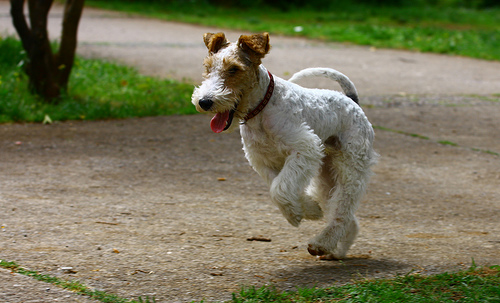

A dog is pulling a red sled across the snow .
Best score: 0.397


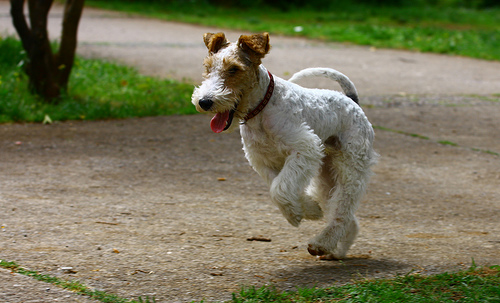

a large dog carrying a large stick in its mouth .
Best score: 0.398


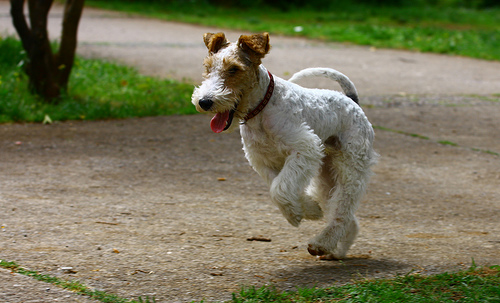

A brown dog and a black and white dog stand beside a hole in the dirt .
Best score: 0.374


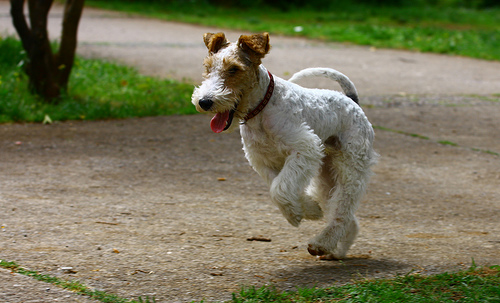

A man waterskiing through the air near a dock .
Best score: 0.395


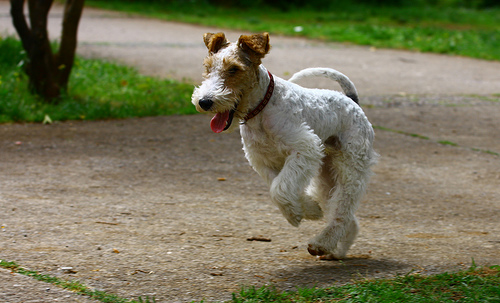

A group of people perform together onstage .
Best score: 0.404


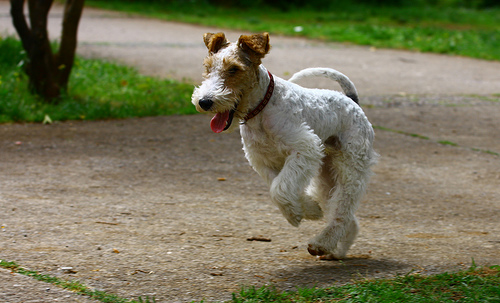

A man lies on a blue blanket with a child on his back .
Best score: 0.396


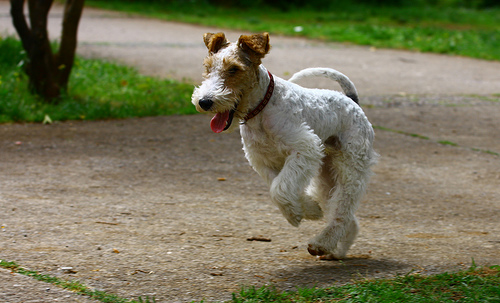

a biker rides down the street .
Best score: 0.389


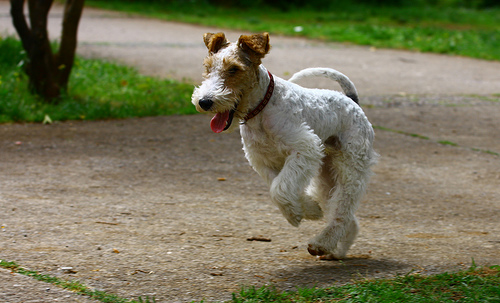

A child flying a kite .
Best score: 0.404


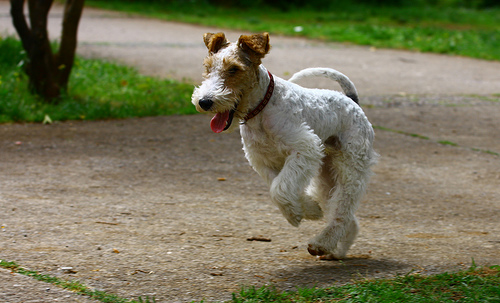

Performers performing a play .
Best score: 0.382


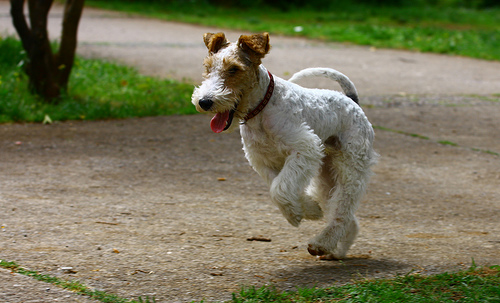

a boy in a blue top is jumping off some rocks in the woods .
Best score: 0.357


In [119]:
# Генерация лучшего изображения для случайных генераторых запросов
for n in range(0, 10):
    # Создание случайного целого числа
    rand_n = random.randint(0, len(list_test_query)-1)

    # Извлечение вашего запроса
    rand_query = list_test_query[rand_n]

    # Отображать фотографий, получивших лучший оценки
   # find_picture_to_caption(rand_query, best_model)
    find_picture_to_caption(rand_query, svr)

Мы ясно видим, что модель не связывает с запросом правильное изображение.

## Прогнозы c лучшей моделью из второй кросс-валидации (БЕРТ оценка)

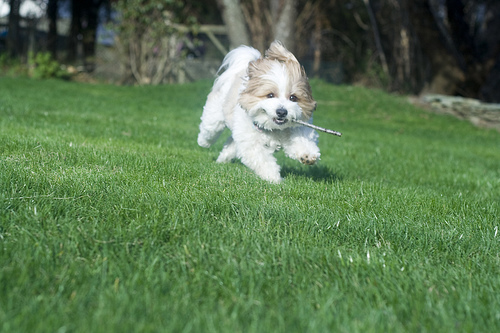

A woman sitting at a sewing machine looks up .
Best score: 0.669


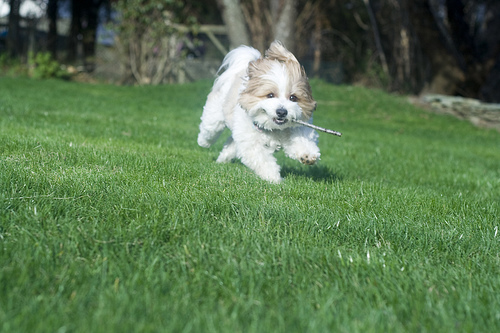

A little girl with purple hat is riding a tricycle along paved road by some farmland .
Best score: 0.655


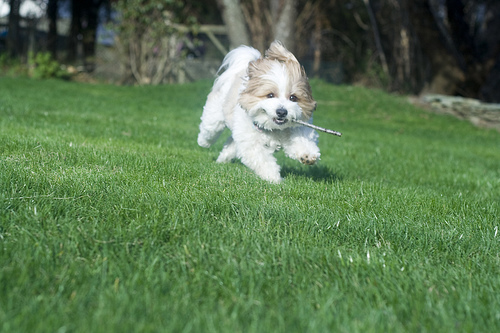

Man rides on bicycle as other people walk .
Best score: 0.659


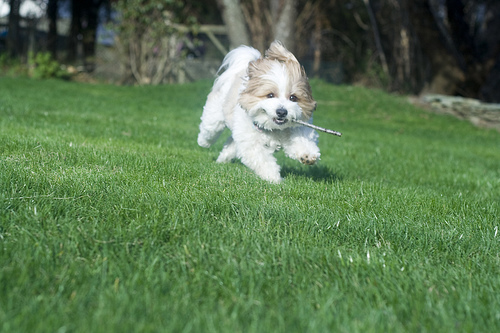

Four young people with cold drinks stand on the sidewalk in front of cartoon cutouts of the Simpsons also holding cold drinks .
Best score: 0.659


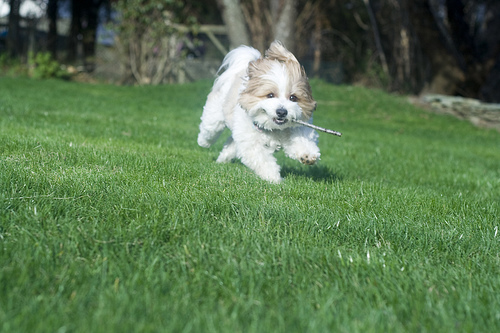

Three teenagers drink Slurpees outside a convienience store .
Best score: 0.65


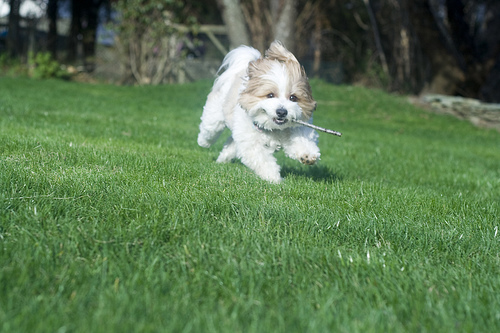

little boy playing basketball in the grass
Best score: 0.659


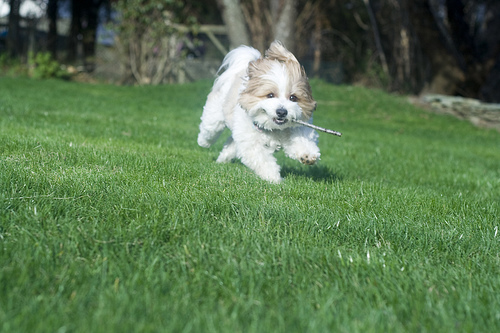

Kids in bathing suits with water splashing around them .
Best score: 0.661


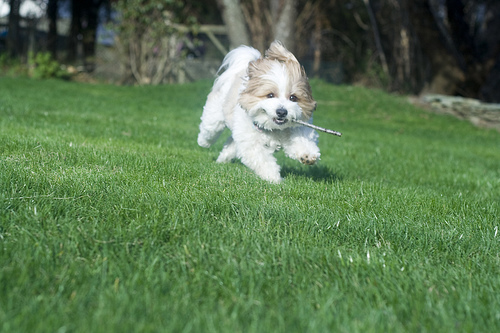

A camera man is behind his video camera and surrounded by a hudge crowd .
Best score: 0.659


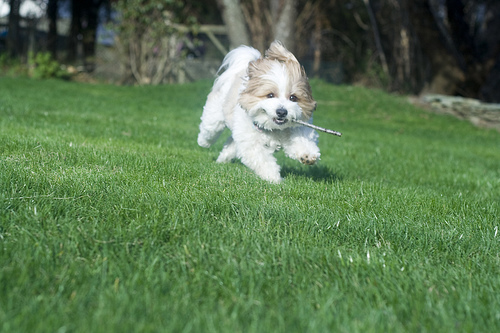

A spotted dog stands on his hind legs to catch a ball on the beach .
Best score: 0.658


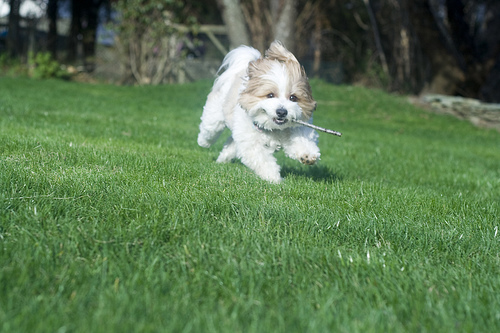

A dog walks across a puddle of water in Las Vegas .
Best score: 0.661


In [120]:
# Генерация лучшего изображения для случайных генераторых запросов
for n in range(0, 10):
    # Создание случайного целого числа
    rand_n = random.randint(0, len(list_test_query)-1)

    # Извлечение вашего запроса
    rand_query = list_test_query[rand_n]

    # Отображать фотографий, получивших лучший оценки
    find_picture_to_caption(rand_query, svr_bert)

Мы ясно видим, что модель не связывает с запросом правильное изображение.

Мы заметили, что всегда возвращаются одни и те же картинки.

## Поиск изображений с помощью CLIP

In [121]:
# Наш список запросов
list_test_query[:5]

['Two blonde boys , one in a camouflage shirt and the other in blue , are having a water fight .',
 'Two boys are squirting water guns at each other .',
 'Two boys spraying each other with water',
 'Two children wearing jeans squirt water at each other .',
 'Two young boys are squirting water at each other .']

In [122]:
# Загрузить модель CLIP
model_clip = SentenceTransformer("clip-ViT-B-32")

In [123]:
# Функция для кодирования изображений с помощью модели CLIP
list_img_vec = []
def img_vect_clip(dataframe):
    # # Цикл по датафрейму
    for index, row in dataframe.iterrows():
        # Получим название изображения:
        img_name = row['image']
        # Закодируем изображение:
        img_emb = model_clip.encode(Image.open(os.path.join(DATA_PATH,'test_images', img_name)))
        # Преобразование массива numpy в torch tensor
        img_emb_torch = torch.from_numpy(img_emb)
        # Добавление тензора в список
        list_img_vec.append(img_emb_torch)
    return torch.stack(list_img_vec) # Return a trorch tensor

In [124]:
# Генерируем наш тензор векторизованных изображений из папки тестирования
list_img_vect = img_vect_clip(df_test_image)

In [125]:
# Функция для кодирования текста
def text_img_clip(text):
    # Кодирование запроса
    return model_clip.encode(rand_query)

In [126]:
# Функция для вычисления сходства между векторизованными изображениеми и векторизованным запросом
def compute_similarities(img_emb, text_emb):
    # Вычисление сходства
    similarity_scores = model_clip.similarity(img_emb, text_emb)
    score = (similarity_scores==torch.max(similarity_scores)).nonzero()
    index = score[0][0].item()
    image_found = df_test_image.loc[index, 'image']
    img = Image.open(os.path.join(DATA_PATH,'test_images', image_found))
    if image_found in images_to_remove_test:
        print('This image is not available!')
    else:
        display(img)
    print(rand_query)
    print(f'Similarity score: {round(similarity_scores.max().item(), 3)}')

This image is not available!
A bicyclist is jumping on ramp covered with graffiti .
Similarity score: 0.279


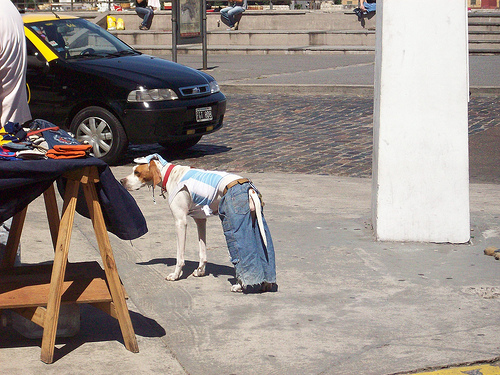

A dog is wearing jeans and a blue and yellow shirt with a black vehicle in the background .
Similarity score: 0.338


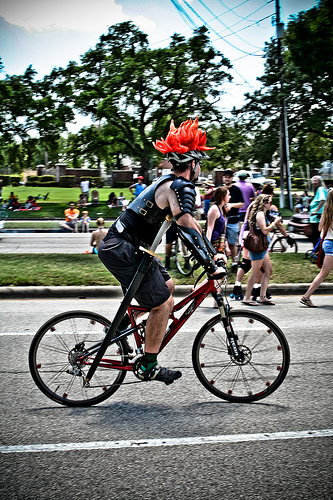

A man on an orange bike .
Similarity score: 0.291


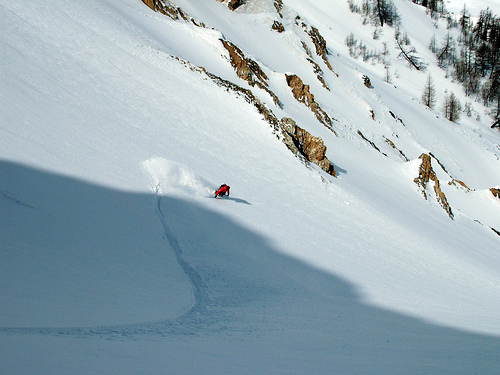

Skier in red skiing down a snowy mountain .
Similarity score: 0.31


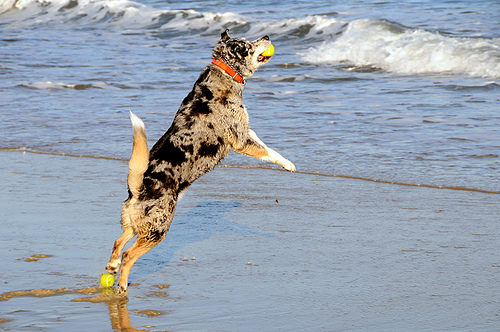

A spotted dog stands on his hind legs to catch a ball on the beach .
Similarity score: 0.359


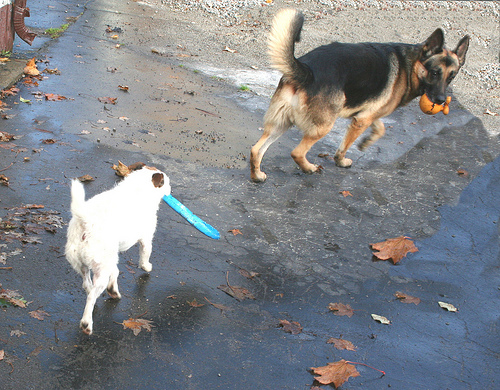

Two dogs are shaking themselves dry on the path next to the water .
Similarity score: 0.3


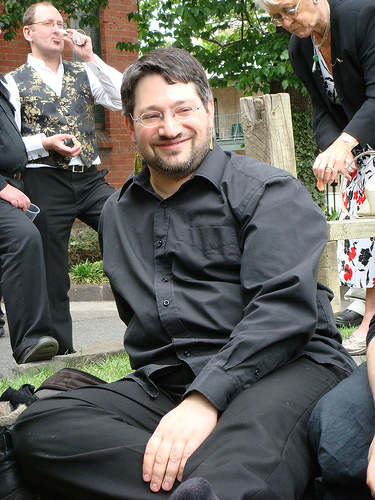

A man with glasses wearing all black sits on grass surrounded by other people .
Similarity score: 0.347


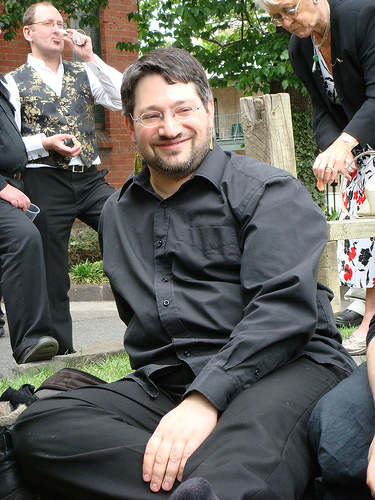

A man wearing glasses and black clothing is sitting while a man in a vest drinks in the background .
Similarity score: 0.303


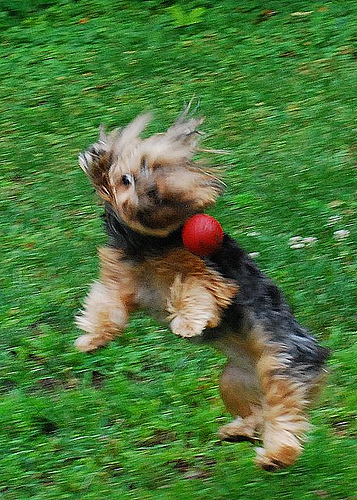

A dog jumps to catch a red ball outside .
Similarity score: 0.337
This image is not available!
A little boy plays with a basketball and a toy basketball hoop .
Similarity score: 0.325


In [127]:
# Цикл через 10 случайно выбранных запросов
for n in range(0, 10):
    # Генерация случайного целого числа
    rand_n = random.randint(0, len(list_test_query)-1)
    # Случайное извлечение запроса
    rand_query = list_test_query[rand_n]
    # Кодирование текста
    text_emb = text_img_clip(rand_query)
    compute_similarities(list_img_vect, text_emb)

Мы видим, что с помощью библиотеки CLIP нам удалось получить нужные картинки.

## Вывод

В заключение мы видим, что наши модель не сработала очень хорошо, но библиотека CLIP справилась.

# Общее вывод

Мы создали модель, основанную на большинстве экспертных оценок. Мы также экспериментировали с моделью, используя в качестве целовой признак, Берт оценки.

При этом мы также исключили детские изображения из набора обучающих данных.

Эти модели были обучены посредством кросс-валидации с использованием извлечения признаков с помощью Resnet18 для векторизации изображений и Bert для векторизации текста.

К сожалению, обе модели не показали хороших результатов во время тестирования, вероятно, это связано с самим подходом, который пытается создать модель на основе оценок, полученных людьми.. Однако нам удалось добиться хорошего результата с библиотекой CLIP которы исползовать косинусное сходство.